# Lab Three
### CRISP-DM Capstone: Association Rule Mining, Clustering, or Collaborative Filtering
#### Ricco Ferraro, David Grijalva, Nicole Norelli, & Mingyang Nick Yu

__NBViewer Link:__ <a href="">Rendered Lab3</a>

# Business Understanding 1
We selected data from LendingClub, a peer-to-peer lending company where individuals can apply for loans and investors can elect to commit money. The dataset we downloaded was from Kaggle. It contains 2,925,493 records and 141 attributes collected between 2007 and 2020 and was available to the public through LendingClub. The original purpose of the data collected was for LendingClub to accept or reject a loan application as well as assign the loan a grade and interest rate. This is a valuable dataset because each entry has extensive information about the borrower, loan terms, and loan outcome.

The variable we chose to predict is loan outcome. Loan outcome is a variable we created indicating whether the loan is good ("fully paid", "current", "in grace period", and "issued") or bad ("charged off", "late", and "default"). Prediction of loan outcome is useful, as it allows investors to make better, more informed decisions when deciding to fund a loan. The ability to predict if a particular loan will be fully paid or charged off (deemed un-collectible) allows investors to optimize their investments. There is value in making this prediction prospectively before a lender grants a loan or alternately midway through the life of an existing loan.  

We will explore various methods of cluster analysis as a pre-processing step prior to fitting predictive models. The prediction is a classification problem and we plan to use the precision of each group as an evaluation metric. A high precision for the good loan group would allow LendingClub to continue offering loans to this group of people and to collect interest from good loans. A high precision for the bad loan group can help LendingClub detect potential bad loans prior to issuance and save money from potential bad loans. 

The goal of clustering is to improve the precision of the predictive models. To that end, we will use 10-fold cross-validation on the training set to tune cluster analysis hyperparameters and fit classification models, and then use the test set to compare the results of our chosen models. These results will also be compared to the same classification model methods without the cluster analysis pre-processing step, to determine if cluster analysis adds value. Ultimately, cluster analysis will only add value if incorporating it improves the precision of our loan outcome predictions.


_https://www.lendingclub.com_

_https://www.kaggle.com/ethon0426/lending-club-20072020q1_

In [1]:
# Other imports
import pandas as pd
import numpy as np
import datetime
import warnings
warnings.filterwarnings("ignore")
import pickle
import joblib
from scipy import interp
from itertools import cycle


# sklearn imports
from sklearn.preprocessing import OneHotEncoder, StandardScaler, label_binarize, LabelEncoder
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import cross_validate, StratifiedKFold, train_test_split,RandomizedSearchCV,GridSearchCV,cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report,plot_confusion_matrix,plot_roc_curve,auc,roc_curve,confusion_matrix,accuracy_score
from sklearn.base import BaseEstimator,TransformerMixin
from sklearn.base import BaseEstimator,TransformerMixin

# vizualization 
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from IPython.core.display import display, HTML
import plotly.express as px
from matplotlib import pyplot as plt
%matplotlib inline
plt.style.use('ggplot')

# Model A/B test
import scipy
from scipy import stats

# Clustering Techniques
from sklearn.cluster import KMeans
from sklearn.cluster import Birch
from sklearn.cluster import SpectralClustering
from sklearn.mixture import GaussianMixture

# Notebook options
pd.options.display.max_rows = 99999
pd.options.display.max_columns = 99999
# Usint fixed os structure
import os
cwd = os.getcwd()
d = os.path.dirname(cwd)

# Data Understanding 1

In [2]:
# set
path = f"{d}/data/loan_100k_sample.pkl"
%time data = pd.read_pickle(path).reset_index()
data.drop('index',axis=1,inplace=True)

CPU times: user 170 ms, sys: 97.6 ms, total: 268 ms
Wall time: 266 ms


#### Subset of the full data set
Because our dataset was so large, we decided to take a random subset of 100,000 records beginning in January 2015. We believed more recent data would be more representative of current financial conditions for our model. The longest loans available from LendingClub are 60 months, so choosing a cut-off of more than five years in the past should allow for  records from a variety of points within the two loan terms (ranging from just issued to paid off).

## Data Quality
### Missing Data

In [3]:
# Identify attributes missing over 15% of values
columns_missing_rate = 100*(data.isnull().sum(axis = 0) / len(data))
columns_missing_rate = pd.DataFrame(columns_missing_rate)
columns_missing_rate = columns_missing_rate.reset_index()
columns_missing_rate.columns = ['name','rate']
print("     Initial Missing Data Inspection with all Attributes In     \n")
print('{:45s} {:4s}%'.format("Variable Name:","Missing Percentage"))
print("________________________________________________________________")
for index, row in columns_missing_rate.iterrows():
    if row['rate'] > 0:
        print(' {:45s} {:4s}%'.format(row['name'],str(np.round(row['rate'],4))))

     Initial Missing Data Inspection with all Attributes In     

Variable Name:                                Missing Percentage%
________________________________________________________________
 emp_title                                     9.557%
 emp_length                                    7.468%
 title                                         0.967%
 dti                                           0.113%
 inq_last_6mths                                0.001%
 mths_since_last_delinq                        52.227%
 mths_since_last_record                        85.29%
 revol_util                                    0.08%
 last_pymnt_d                                  0.203%
 next_pymnt_d                                  56.961%
 last_credit_pull_d                            0.001%
 mths_since_last_major_derog                   74.639%
 annual_inc_joint                              91.643%
 dti_joint                                     91.643%
 verification_status_joint                 

__The following code chunk is the process of dropping attributes (see Deletion below)__

In [4]:
columns_to_delete = []
for index, row in columns_missing_rate.iterrows():
    if row['rate'] >= 15:
        columns_to_delete.append(row['name'])
columns_to_delete.sort()
# Keep sec_app_fico variables for later use
columns_to_delete.remove('sec_app_fico_range_low')
columns_to_delete.remove('sec_app_fico_range_high')
data.drop(columns_to_delete,axis=1,inplace=True)
group_agreed_deletation = ['id','sub_grade','initial_list_status','last_credit_pull_d',
                           'mths_since_recent_inq','num_accts_ever_120_pd',
                          'num_bc_sats','num_bc_tl','num_op_rev_tl','num_rev_accts',
                          'num_rev_tl_bal_gt_0','num_sats','num_tl_120dpd_2m',
                          'num_tl_30dpd','num_tl_op_past_12m','total_pymnt',
                          'total_pymnt_inv','url','zip_code','emp_title']
data.drop(group_agreed_deletation,axis=1,inplace=True)
nick_suggested_deletation = ['avg_cur_bal','bc_open_to_buy','collection_recovery_fee',
                             'funded_amnt','funded_amnt_inv','installment','num_actv_bc_tl',
                            'out_prncp_inv','percent_bc_gt_75','policy_code','pub_rec',
                             'tot_hi_cred_lim','total_acc','total_il_high_credit_limit',
                            'total_rec_int','total_rev_hi_lim','pymnt_plan','title']
data.drop(nick_suggested_deletation,axis=1,inplace=True)

__The following code chunk is the process of imputation (see Imputation below)__

In [5]:
# Imputation
# Write code chunk fixing emp_length NA to less than one year
def emp_length_fix(x: str):
    if isinstance(x, str):
        return x
    elif np.isnan(x):
        x = "< 1 year"
        return x
    else:
        pass
data["emp_length"] = data["emp_length"].apply(lambda x: emp_length_fix(x))

# dti - most missing values have annual_inc of 0
# We decided to impute dti to 999 - with observations that has super low annual_inc
def dti_impute(num):
    if np.isnan(num):
        return 999.0
    else:
        return num
data['dti'] = data["dti"].apply(lambda x: dti_impute(x))

# bc_util (Ratio of total current balance to high credit/credit limit for all bankcard accounts).
# Assign to 0.0 if not available - reason discussed
data['bc_util'].fillna(0.0, inplace=True)

# mo_sin_old_il_acct (Months since oldest bank installment account opened)
# Assigned to 0.0 since haven't had installment account opened before
data['mo_sin_old_il_acct'].fillna(0.0, inplace=True)
# mths_since_recent_bc (Months since most recent bankcard account opened.)
# Assign to 0.0 since no recent bankcard is opened based on other columns
data['mths_since_recent_bc'].fillna(0.0, inplace=True)

# Write code chunk fixing hardship_flag NA to N
def hardship_flag_fix(x: str):
    if isinstance(x, str):
        return x
    elif np.isnan(x):
        x = "N"
        return x
    else:
        pass
data["hardship_flag"] = data["hardship_flag"].apply(lambda x: hardship_flag_fix(x))

# Fixing revol_util - assign to zero, when revol_util is not available
# revol_bal revolving balance is either zero or it is a charge card 
# (because they don't have a credit limit, they aren't factored into utilization ratio)
data['revol_util'].fillna('0.0%', inplace=True)

# Based on one missing value on inq_last_6mths 
# it seems rare case just didn't have any inquiries in last 6 month
data['inq_last_6mths'].fillna(0.0, inplace=True)

In [6]:
columns_missing_rate = 100*(data.isnull().sum(axis = 0) / len(data))
columns_missing_rate = pd.DataFrame(columns_missing_rate)
columns_missing_rate = columns_missing_rate.reset_index()
columns_missing_rate.columns = ['name','rate']
print('{:30s} {:4s}%'.format("Variable Name:","Missing Percentage"))
print("___________________________________________________")
for index, row in columns_missing_rate.iterrows():
    if row['rate'] > 0:
        print(' {:30s} {:4s}%'.format(row['name'],str(np.round(row['rate'],4))))

Variable Name:                 Missing Percentage%
___________________________________________________
 last_pymnt_d                   0.203%
 sec_app_fico_range_low         92.138%
 sec_app_fico_range_high        92.138%


#### Deletion
First, we determined all attributes with 15% or more missing values. Many of the attributes with large missing percentages were details regarding special cases. For example, approximately 5% of the records were "hardship" cases, and approximately 7% of the records were joint applications. Each of these special cases had approximately 15 associated attributes. We chose to remove the attributes related to these special cases because imputation would not make sense for records to which they do not apply, and the percentage of missing values was, of course, very high. However, both of these special cases had indicator variables, which we retained in the data set. This will allow us to identify if particular cases are joint applications or hardship cases. We also chose to temporarily keep data regarding a secondary loan applicant's FICO score in order to utilize it to create a new FICO feature later in Project One.

There were additional attributes missing moderate to large amounts of data (approximately 15% - 80%), and we chose to delete them as well. The majority of these described how many of a particular type of account had been opened in the recent past. Many of them were redundant with attributes we ultimately kept. It was not clear if missing data in these attributes indicated individuals had not opened accounts recently or if their data was just missing. With such a high percentage of missing entries, we felt deletion was the better choice for these attributes. 

#### (Additional Variable Removal)
While cleaning the dataset, we identified attributes to remove that would not be useful for our future models. Some, such as _ID, URL_, or _job title_ had too many unique values to be usable in a model. Others, such as _zipcode_, had masked information that made them uninformative. There were also attributes like _policy code_ that only contained one value. We removed these attributes.

Also, in an effort to reduce our dataset to a more manageable size for the scope of this class, we examined attributes with very high correlations. For some of these attributes we used intuition and research and kept only those that were most informative for our purposes.

#### Imputation
For attributes with a smaller percentage of missing data we decided to impute values. We examined each attribute to determine the best imputation method. 

For _Months since most recent bankcard account opened, Months since oldest bank installment account opened, and Ratio of total current balance to high credit/credit limit for all bankcard accounts_, we discovered the data was missing due to lack of these types of accounts. We felt that imputing 0 was the most logical option in these cases. 

For _employment length_, we found indications among the other attributes that missing values meant the individual was unemployed and therefore imputed a "less than one year" value.

For _hardship flag_ missing values, we found no other fields with hardship information and inferred these were not hardship cases, so we imputed "No."

For _dti_ we attempted to impute a value based on the individual's income and total balance excluding mortgage; however, we found the individuals with no DTI value had no listed income. Exploring the DTI attribute, we confirmed the individuals with the highest values had the lowest incomes. While it was not a perfect solution, we chose to impute the maximum DTI value for those who had zero income, grouping them with those who had very small listed incomes.

For _revolving line utilization rate_, which measures the amount of credit the borrower is using relative to all available revolving credit,  we found most of the missing values also had a revolving balance of zero. In the cases where that was not true, a balance was being carried on a charge card rather than a credit card. We felt that imputing 0 was the best option for these missing values.

For last_pymt_d, we did not impute for missing values. The attribute is difficult to use in its current form because it is in datetime format. We left in the missing values, knowing we are likely to exclude this variable in most of our model builds.

Finally, we imputed a zero value for a single missing _inquiries in the last six months_ as it seemed to indicate there had been no recent inquiries.

### Duplicate Data

In [7]:
data[data.duplicated()] 

,loan_amnt,term,int_rate,grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,revol_bal,revol_util,out_prncp,total_rec_prncp,total_rec_late_fee,recoveries,last_pymnt_d,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,acc_open_past_24mths,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,num_actv_rev_tl,num_il_tl,num_tl_90g_dpd_24m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,total_bc_limit,sec_app_fico_range_low,sec_app_fico_range_high,hardship_flag,debt_settlement_flag


We found no duplicate entries in the dataset.

### Outliers

In [8]:
# Scale numeric variables to get a sense for some outliers
scaler = StandardScaler()
scaler.fit(data.select_dtypes(include=[float,int]))
scaled_data = scaler.transform(data.select_dtypes(include=[float,int]))
scaled_data = pd.DataFrame(scaled_data,columns =data.select_dtypes(include=[float,int]).columns )

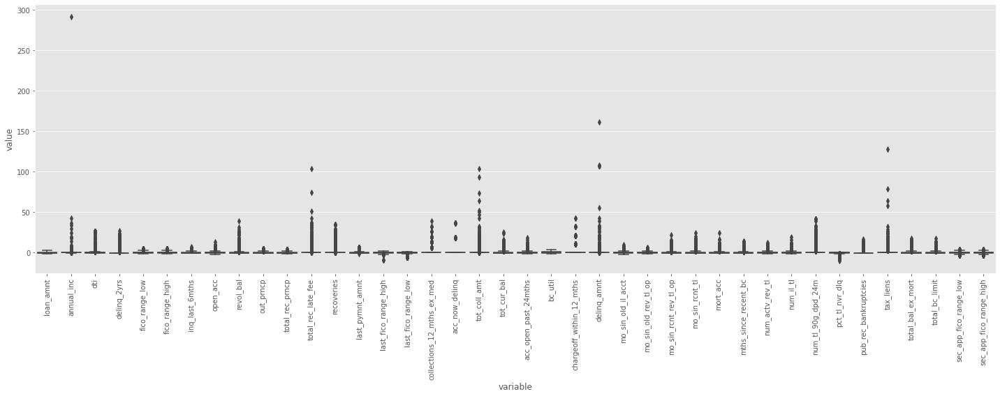

In [9]:
plt.figure(figsize=(20,8))
g = sns.boxplot(x="variable", y="value", data=pd.melt(scaled_data))
g.set_xticklabels(g.get_xticklabels(), rotation=90)
plt.tight_layout()
plt.show()

To get a sense for the overall outliers and to identify some of the more extreme cases, we standardized each of the continuous variables and examined the standardized boxplots (seen above). This highlights the extreme values in _annual income, delinquent amount, tax liens, total collection amounts ever owed, and late fees received to date_. It is also apparent that the dataset has outliers in most of the continuous variables. 

In [10]:
z_scores = z = np.abs(stats.zscore(data.select_dtypes(include=["number"]), nan_policy="omit"))
z_scores_df = pd.DataFrame(z_scores, columns=data.select_dtypes(include=["number"]).columns)
z_scores_df_mask = z_scores_df.gt(3)
z_value_dict = {}
for i in range(len(z_scores_df.columns)):
    feature_name = list(z_scores_df.columns)[i]
    x = z_scores_df_mask[feature_name].value_counts()
    if len(x)>1:
        z_value_dict[feature_name] = x[1]
    else: 
        z_value_dict[feature_name] = 0

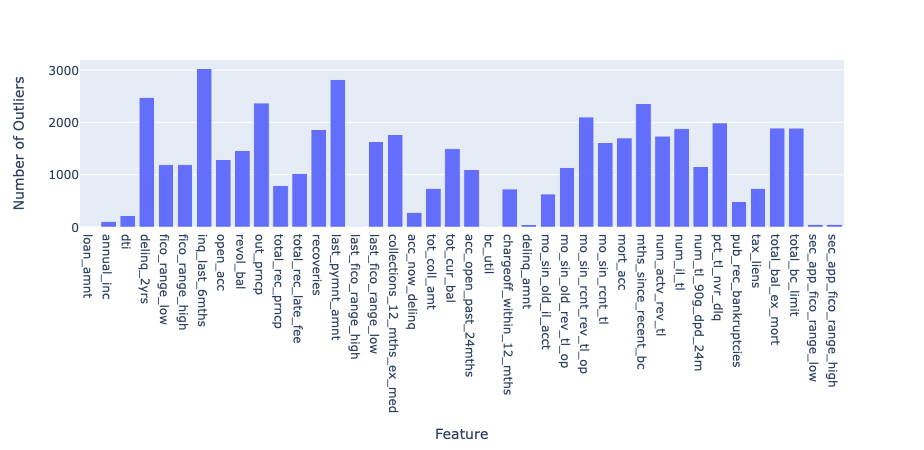

In [11]:
df_outliers = pd.DataFrame.from_dict(z_value_dict, orient="index").reset_index()
df_outliers = df_outliers.rename(columns={"index": "Feature", 0:"Number of Outliers"})
fig = px.bar(df_outliers, x='Feature', y='Number of Outliers')
fig.show()

We created this bar graph to determine how many outliers were contained within each attribute. Of course, exploring all outliers would be excessive, so we selected examples of attributes with extreme outliers to address in depth below.

In [12]:
# Explore Annual Income
data.nlargest(5, ['annual_inc'])

,loan_amnt,term,int_rate,grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,revol_bal,revol_util,out_prncp,total_rec_prncp,total_rec_late_fee,recoveries,last_pymnt_d,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,acc_open_past_24mths,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,num_actv_rev_tl,num_il_tl,num_tl_90g_dpd_24m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,total_bc_limit,sec_app_fico_range_low,sec_app_fico_range_high,hardship_flag,debt_settlement_flag
76279,10000.0,36 months,11.44%,B,10+ years,MORTGAGE,61000000.0,Source Verified,2017-03-01,Fully Paid,debt_consolidation,VA,0.01,0.0,1996-04-01,690.0,694.0,1.0,3.0,14413.0,35.1%,0.00,10000.00,0.0,0.0,2020-03-01,330.17,679.0,675.0,0.0,Individual,0.0,0.0,14413.0,0.0,23.2,0.0,0.0,0.0,251.0,140.0,140.0,0.0,192.0,3.0,0.0,0.0,66.7,0.0,0.0,14413.0,31800.0,NaN,NaN,N,N
39514,22000.0,36 months,5.32%,A,10+ years,MORTGAGE,8900000.0,Source Verified,2017-04-01,Fully Paid,credit_card,FL,0.22,0.0,1994-11-01,760.0,764.0,1.0,9.0,37284.0,39%,0.00,22000.00,0.0,0.0,2020-04-01,662.34,804.0,800.0,0.0,Individual,0.0,0.0,292988.0,1.0,39.0,0.0,0.0,144.0,269.0,59.0,16.0,3.0,59.0,4.0,5.0,0.0,100.0,0.0,0.0,53175.0,95600.0,NaN,NaN,N,N
79670,10000.0,36 months,6.89%,A,3 years,MORTGAGE,7600000.0,Source Verified,2015-09-01,Fully Paid,home_improvement,SC,0.09,10.0,1989-02-01,700.0,704.0,1.0,18.0,2494.0,15.7%,0.00,10000.00,0.0,0.0,2016-01-01,26.53,569.0,565.0,0.0,Individual,0.0,432.0,72572.0,3.0,19.1,0.0,0.0,105.0,319.0,2.0,2.0,1.0,2.0,6.0,4.0,1.0,40.7,0.0,0.0,17683.0,8600.0,NaN,NaN,N,N
88103,38000.0,60 months,8.81%,A,10+ years,MORTGAGE,7200000.0,Verified,2019-04-01,Current,credit_card,NY,0.24,0.0,2007-12-01,695.0,699.0,2.0,20.0,57205.0,51%,31119.72,6880.28,0.0,0.0,2020-05-01,785.32,684.0,680.0,0.0,Individual,0.0,0.0,181773.0,8.0,46.5,0.0,0.0,84.0,136.0,4.0,4.0,2.0,5.0,14.0,7.0,0.0,100.0,0.0,0.0,61737.0,74700.0,NaN,NaN,N,N
22565,6000.0,36 months,16.14%,C,4 years,MORTGAGE,6286908.0,Source Verified,2019-02-01,Fully Paid,debt_consolidation,FL,0.08,0.0,2010-09-01,660.0,664.0,1.0,5.0,7329.0,63.7%,0.00,6000.00,0.0,0.0,2019-09-01,63.32,659.0,655.0,0.0,Individual,0.0,0.0,32877.0,2.0,3.1,0.0,0.0,101.0,82.0,19.0,19.0,0.0,82.0,3.0,4.0,0.0,75.0,1.0,0.0,32877.0,2000.0,NaN,NaN,N,N


In [13]:
sum(data.annual_inc > 1000000)

35

_Annual Income_: While we expected income data to be right skewed with some high outliers, we took a closer look at the top few entries. Although the income level was very high, most of the records in this range were listed as verified.  This indicated borrowers submitted documents to LendingClub (such as pay stubs or bank statements), so we had no strong evidence that they were mistakes. However, we might consider restricting the range of annual income to less than 1 million dollars. We would only exclude 35 entries, and it is certainly possible that even though they are verified, these are data entry mistakes or falsifications on the part of the applicant. It is possible that someone with an annual income of 61 million dollars could take out a 10,000 dollar loan, but it would certainly be surprising.

In [14]:
# Explore Total Collection Amounts Ever Owed
data.nlargest(5, ['tot_coll_amt'])

,loan_amnt,term,int_rate,grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,revol_bal,revol_util,out_prncp,total_rec_prncp,total_rec_late_fee,recoveries,last_pymnt_d,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,acc_open_past_24mths,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,num_actv_rev_tl,num_il_tl,num_tl_90g_dpd_24m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,total_bc_limit,sec_app_fico_range_low,sec_app_fico_range_high,hardship_flag,debt_settlement_flag
50876,15000.0,36 months,10.42%,B,9 years,RENT,125000.0,Source Verified,2017-12-01,Fully Paid,debt_consolidation,CO,10.46,0.0,1991-09-01,680.0,684.0,1.0,9.0,7006.0,39.8%,0.00,15000.00,0.00,0.0,2019-08-01,7738.29,669.0,665.0,0.0,Individual,0.0,188066.0,647047.0,4.0,4.1,0.0,0.0,315.0,192.0,1.0,1.0,5.0,1.0,5.0,7.0,0.0,74.1,0.0,0.0,241663.0,10000.0,NaN,NaN,N,N
93885,6600.0,36 months,15.41%,D,3 years,MORTGAGE,54000.0,Not Verified,2015-11-01,Fully Paid,credit_card,CA,5.24,1.0,2004-10-01,670.0,674.0,0.0,17.0,6287.0,52.4%,0.00,6600.00,0.00,0.0,2016-09-01,5324.18,534.0,530.0,0.0,Individual,0.0,169257.0,429876.0,10.0,70.7,0.0,0.0,133.0,16.0,8.0,8.0,1.0,8.0,4.0,16.0,1.0,95.2,0.0,0.0,48495.0,1000.0,NaN,NaN,N,N
37000,33600.0,60 months,11.80%,B,10+ years,RENT,120275.0,Not Verified,2019-01-01,Current,credit_card,VA,18.21,0.0,1995-02-01,710.0,714.0,0.0,7.0,19337.0,39.1%,26470.71,7129.29,0.00,0.0,2020-05-01,744.03,719.0,715.0,0.0,Individual,0.0,132733.0,44327.0,1.0,13.4,0.0,0.0,90.0,287.0,43.0,23.0,0.0,59.0,3.0,10.0,0.0,100.0,0.0,0.0,44327.0,25500.0,NaN,NaN,N,N
95486,5000.0,36 months,9.93%,B,5 years,RENT,33000.0,Not Verified,2017-05-01,Fully Paid,debt_consolidation,MO,4.07,0.0,2008-05-01,660.0,664.0,0.0,4.0,3329.0,32.3%,0.00,5000.00,0.00,0.0,2018-10-01,2987.04,774.0,770.0,0.0,Individual,0.0,116695.0,3329.0,0.0,40.0,0.0,0.0,99.0,108.0,37.0,37.0,0.0,40.0,3.0,2.0,0.0,91.7,0.0,1.0,3329.0,7300.0,NaN,NaN,N,N
61483,10000.0,36 months,16.02%,C,3 years,MORTGAGE,63705.0,Not Verified,2017-05-01,Fully Paid,debt_consolidation,SC,29.35,0.0,2005-02-01,660.0,664.0,1.0,12.0,4414.0,39.1%,0.00,10000.00,17.58,0.0,2019-07-01,3981.26,664.0,660.0,0.0,Individual,0.0,94670.0,123125.0,9.0,31.8,0.0,0.0,125.0,146.0,6.0,6.0,3.0,45.0,6.0,11.0,0.0,66.7,0.0,2.0,40175.0,6800.0,NaN,NaN,N,N


The most extreme value in _total collection amounts ever owed_ is high but not unreasonable. It does not appear to be an error, and only a few top values are over 100,000. This is important information, so excluding these values would be a poor option. 

In [15]:
# Explore Tax Liens
data.nlargest(5, ['tax_liens'])

,loan_amnt,term,int_rate,grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,revol_bal,revol_util,out_prncp,total_rec_prncp,total_rec_late_fee,recoveries,last_pymnt_d,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,acc_open_past_24mths,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,num_actv_rev_tl,num_il_tl,num_tl_90g_dpd_24m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,total_bc_limit,sec_app_fico_range_low,sec_app_fico_range_high,hardship_flag,debt_settlement_flag
75993,8500.0,36 months,16.02%,C,10+ years,RENT,176000.0,Not Verified,2017-07-01,Charged Off,other,IL,5.28,0.0,1992-12-01,690.0,694.0,3.0,9.0,15991.0,52.6%,0.0,3745.16,0.0,0.00,2019-01-01,298.92,539.0,535.0,0.0,Individual,0.0,0.0,24974.0,6.0,70.4,0.0,0.0,148.0,294.0,6.0,3.0,0.0,6.0,5.0,3.0,0.0,88.9,0.0,44.0,24974.0,20100.0,NaN,NaN,N,N
52711,7000.0,36 months,11.49%,B,< 1 year,OWN,45000.0,Not Verified,2015-11-01,Fully Paid,credit_card,IN,34.37,0.0,1987-11-01,680.0,684.0,0.0,14.0,81045.0,18.7%,0.0,7000.00,0.0,0.00,2018-11-01,230.75,799.0,795.0,0.0,Individual,0.0,1335.0,94584.0,3.0,18.2,0.0,0.0,140.0,336.0,18.0,18.0,11.0,31.0,8.0,6.0,0.0,100.0,1.0,27.0,94584.0,101000.0,NaN,NaN,N,N
23210,12000.0,36 months,11.99%,C,4 years,RENT,60000.0,Source Verified,2015-12-01,Fully Paid,debt_consolidation,OR,14.12,0.0,1996-05-01,680.0,684.0,0.0,9.0,4858.0,36.3%,0.0,12000.00,0.0,0.00,2019-01-01,3.96,549.0,545.0,0.0,Individual,0.0,1988.0,23892.0,10.0,68.9,0.0,0.0,19.0,169.0,3.0,3.0,2.0,3.0,6.0,1.0,0.0,100.0,1.0,22.0,23892.0,1600.0,NaN,NaN,N,N
30663,18000.0,60 months,14.46%,C,6 years,RENT,86000.0,Not Verified,2016-02-01,Fully Paid,debt_consolidation,GA,15.11,0.0,1999-11-01,660.0,664.0,0.0,11.0,4014.0,41.8%,0.0,18000.00,0.0,0.00,2018-10-01,4012.42,689.0,685.0,0.0,Individual,0.0,0.0,144570.0,3.0,41.8,0.0,0.0,147.0,195.0,17.0,11.0,2.0,17.0,1.0,26.0,0.0,94.9,1.0,20.0,144570.0,9600.0,NaN,NaN,N,N
83888,20000.0,36 months,28.69%,F,3 years,RENT,68000.0,Source Verified,2017-02-01,Charged Off,other,CA,10.10,0.0,1979-01-01,685.0,689.0,0.0,5.0,7222.0,34.1%,0.0,0.00,0.0,13459.54,NaT,0.00,584.0,580.0,0.0,Individual,0.0,0.0,31857.0,4.0,38.6,0.0,0.0,136.0,456.0,1.0,1.0,0.0,1.0,3.0,5.0,0.0,86.7,0.0,11.0,31857.0,18700.0,NaN,NaN,N,Y


The top few values in the _tax lien_ attribute are quite large. Tax leins occur when the government places a lien on a property because the individual has not properly paid taxes. The top value with 44 tax liens seems a poor candidate for a peer to peer loan, but it is not an implausible number. We cannot infer these outlying values are errors.

Overall, our dataset has outliers in most of the continuous variables. This is not unexpected in a large dataset with many financial attributes. Some, like _annual income_, might benefit from a restricted range of values in order to eliminate values that seem unlikely to be correct. We have also identified _annual income, total credit revolving balance, total balance excluding mortgage, and total bankcard credit limit_ as attributes with larger outliers we may want to consider modifying depending upon methods used. Because we will use a variety of clustering and classification techniques, the effects of outliers will be considered for specific methods rather than on the dataset as a whole.

## New Features

Although we created new features later in our exploratory data analysis process, we would like to introduce them at this point. This will allow us to remove the secondary FICO attributes we temporarily kept before we address data types and simple statistics. More importantly, we would like to use some of our new features when we visualize our data in later sections. For instance, our simplified loan outcome variable (described below) allows for visualizations that are easier to interpret in some instances.

In [16]:
def str_to_rate(x: str):
    if isinstance(x, str):
        x = x[:-1]
        return float(x)
    elif np.isnan(x):
        return x
    else:
        pass
    
def remove_pattern(pattern: str, original: str):
    if isinstance(original, str):
        original = original.lower()
        return int(re.sub(pattern, '', original ))
    else:
        return np.nan
        
def str_date(x: str):
    if isinstance(x, str):
        x = datetime.datetime.strptime(x, '%b-%Y')
    else:
        x= np.nan
    return x

def credit_days(date2: datetime.date, date1: datetime.datetime.date):
    if isinstance(date2, datetime.date) and isinstance(date1, datetime.date):
        difference = date2 - date1
        return int(difference.days)
    else:
        return np.nan

def build_hist(data: pd.DataFrame, x: str):
    fig = px.histogram(data, x=x)
    fig.show()
    
def hist_by_group(data: pd.DataFrame,x: str, grp: str):
    fig = px.histogram(data, x=x,
        color = grp)
    fig.show()

In [17]:
def create_variables_data(data):
    #  Drop nan from earliest_cr_line  to ensure the credit_days function runs properly
    #crates new feature called days_with_credit from issue_d and earliest_cr_line
    data = data.dropna(subset=["earliest_cr_line"], axis=0)
    data['days_with_credit'] = data[['issue_d','earliest_cr_line']].apply(lambda x: credit_days(*x), axis=1)
    # Overall intial FICO score called 'overall_fico' that includes a secondary applicants score were applicable
    # Most recent FICO score called 'last_fico' that uses initial FICO score if there was no "last" value
    data['fico'] = (data['fico_range_high']+data['fico_range_low'])/2
    data['last_fico'] = data['last_fico_range_high']-2
    data['last_fico'] = np.where(data['last_fico']<=0,data['fico'],data['last_fico'])
    data['sec_app_fico'] = (data['sec_app_fico_range_high']+data['sec_app_fico_range_low'])/2
    data['overall_fico'] = data[['fico', 'sec_app_fico']].mean(axis=1)
    fico_to_drop = ['fico','fico_range_high','fico_range_low',
                    'last_fico_range_high','last_fico_range_low',
                    'sec_app_fico_range_high','sec_app_fico_range_low','sec_app_fico']
    data.drop(fico_to_drop,axis=1,inplace=True)
    # Creating good_loan_or_not column - consolidating loan_status column
    good_loan_status = ['Fully Paid','Current','In Grace Period','Issued']
    bad_loan_status = ['Charged Off','Late (31-120 days)','Late (16-30 days)','Default']
    #'Fully Paid' in good_loan_status
    def loan_flag(loan_st: str):
        if loan_st in good_loan_status:
            x = 1
            return x
        else:
            x = 0
            return x
    # create good_loan_or_not column 
    data["good_loan_or_not"] = data["loan_status"].apply(lambda x: loan_flag(x))
    # convert int rate string to float
    data["int_rate"] = data["int_rate"].apply(lambda x: str_to_rate(x) )
    # convert revol_util string to float
    data["revol_util"] = data["revol_util"].apply(lambda x: str_to_rate(x) )
    return data
    
data = create_variables_data(data)

First we created a variable called _Days with Credit._ This calculates the number of days between an individual's earliest credit line and the issue date of the loan. The two variables that we used to calculate _Days with Credit_ are not very useful to us in their original format, but we theorize that the length of a person's credit history could be useful in determining the outcome of their loan.

Next we created two new FICO score variables. There were six different FICO-related variables in the original data set, so we wanted to simplify them. First we created _Overall FICO._ This averaged the high and low original FICO score of the applicant.  When there was a secondary applicant on a loan, it averaged the secondary high and low score, and took the average between the primary and secondary applicant.  Next we created _Last FICO._ This averaged the most recent high and low FICO score (the difference between them was four, so we just subtracted 2) and imputed the original FICO value if there was no record of a more recent score.

Finally we created a _Good Loan or Not_ variable. The original data set had eight different loan statuses. Our main goal was to predict if a loan was a good investment.  We grouped "charged off", "late", and "default" individuals together in a bad status, and grouped "fully paid", "current", "in grace period", and "issued" into a good loan status. We then used this new feature as a response variable, obtaining a simple yes/no prediction from our models. It is also useful for exploratory data analysis. Visualization with just two response categories makes it easier to identify potential contributing attributes to loan status.


#### Fix Data Types
We converted string values to float values for the attributes _interest rate_ and _revolving line utilization rate_ so they will be usable and the correct data type moving forward.

## Data Meaning Type

In [18]:
data_dic = pd.read_excel(f"{d}/data/Lab3.xlsx", usecols='A:D', nrows=57,index_col=0)

In [19]:
dataTypes = pd.DataFrame(data.dtypes).reset_index()
data_dic = pd.merge(data_dic, dataTypes, left_on="CSV Feature Name", right_on="index") 
data_dic = data_dic.rename(columns={"Type":"Attribute Type",0: "Data Type", "CSV Feature Name": "Feature"})
data_dic = data_dic[["Feature","Attribute Type","Data Type", "Description"]]
f = data_dic.groupby(['Attribute Type',"Feature","Data Type","Description"]).count()

In [20]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100000 entries, 0 to 99999
Data columns (total 54 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   loan_amnt                   100000 non-null  float64       
 1   term                        100000 non-null  object        
 2   int_rate                    100000 non-null  float64       
 3   grade                       100000 non-null  object        
 4   emp_length                  100000 non-null  object        
 5   home_ownership              100000 non-null  object        
 6   annual_inc                  100000 non-null  float64       
 7   verification_status         100000 non-null  object        
 8   issue_d                     100000 non-null  datetime64[ns]
 9   loan_status                 100000 non-null  object        
 10  purpose                     100000 non-null  object        
 11  addr_state                  100000 non-n

In [21]:
display(HTML(f.to_html() ))

As you can see in the table above, we have 9 nominal, 3 ordinal, 3 interval, and 39 ratio variables. Basic descriptions of each variable are listed to the right in the table. 

Some variables describe demographic information about the loan applicant. For example, _emp length_ is a nominal variable with 11 values. A value of 0 indicates employment length of less than one year, 1 indicates one year, and 10 indicates ten or more years.

Many variables describe the financial status and history of the applicant. For example, _open acc_ is a ratio variable indicating the number of open credit lines on the applicant's credit file, and _revol bal_ is a ratio variable indicating the applicant's total credit revolving balance.

Finally, some variables describe the loan from LendingClub. For example, _term_ is an ordinal variable with two values (36 or 60) that indicates the number of payments on the loan, and _int rate_  is an ordinal variable that indicates the interest rate on the loan.

# Data Understanding 2

annual_inc (annual income) can be an important factor to determine whether a loan will be good or bad. It is also in LendingClub's interest to understand the distribution of income of their customers. This boxplot of annual_inc is created by excluding outliers (very high income customers) and it provides a general visual of the annual income distribution of those that were approved for a loan at LendingClub. From the plot, we can see average income is around 81,000 and median is around 68,000. There were still people with zero income who were approved for a loan; the reason is worth exploring. Having excluded outliers, we can see the higher end of income of customers that are applying for loans is approximately 170,000.

<AxesSubplot:xlabel='annual_inc'>

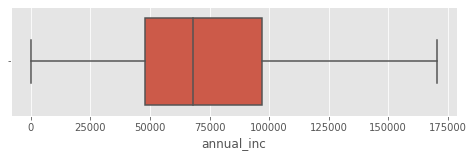

In [22]:
plt.figure(figsize=(8,2))
sns.boxplot(x = data['annual_inc'],showfliers = False)

_purpose_ of a loan can be useful information for LendingClub to know in terms of what their customers are using the loan for, and can be a helpful predictor in evaluating whether they will pay the loan back or not. A countplot/barplot is shown below, demonstrating the number of counts under each group in a straight forward manner. We can see the majority of customers are using loans for _debt_consolidation_, while the least amount of customers are using it for funding renewable energy. A decent percentage of customers are using the loan for their credit card or for home improvement. A small percentage of people are using it for major purchase, medical, house, small business, car, moving, vacation or other reasons.

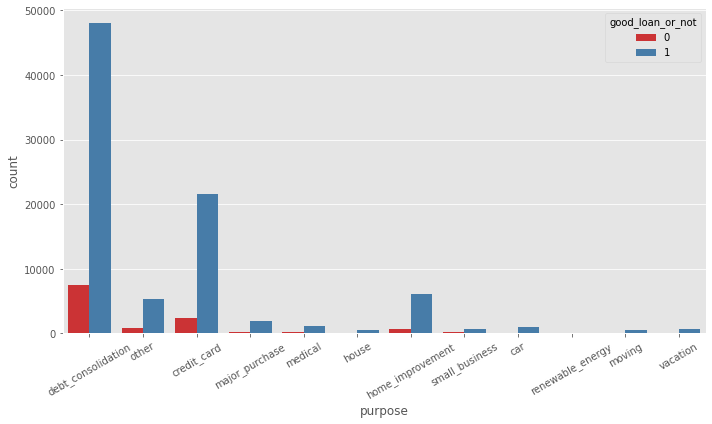

In [23]:
plt.figure(figsize=(10,6))
g = sns.countplot(x='purpose',hue='good_loan_or_not',data=data,palette='Set1')
g.set_xticklabels(g.get_xticklabels(), rotation=30)
plt.tight_layout()
plt.show()

int_rate (interest rate) is LendingClub's indication of a customer's risk factor calculated at the time of application. Based on the link below, LendingClub's interest rate (histogram shown bottom middle) is derived from loan grade (countplot shown bottom right) information. We can see from the boxplot of interest rate (bottom left) the mean and median are around 12.5%. The minimum interest rate LendingClub offers is at 5.31%. A few customers have to pay over 24.30% (in the F and G grade group), some even as high as 30.99%. It is helpful to know the most common interest rates LendingClub offers, and it is very useful to know the relationship between _interest rate_ and _grade_. If we predict _grade_ in future models, _interest rate_ should be deleted since it is directly correlated.

_https://www.lendingclub.com/foliofn/rateDetail.action_

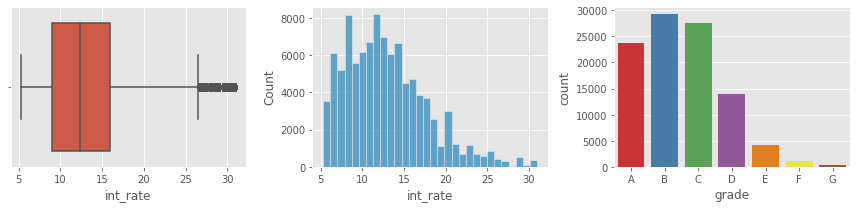

In [24]:
fig, ax = plt.subplots(1,3,figsize=(12,3))
sns.boxplot(x = data['int_rate'],ax=ax[0])
sns.histplot(x = data['int_rate'],bins=30, ax=ax[1])
sns.countplot(x='grade',data=data,palette='Set1', 
              order=['A','B','C','D','E','F','G'],ax=ax[2])
plt.tight_layout()

days_with_credit (days since customer has credit history) is a feature we created based on earliest_cr_line (earliest credit line). This is one of the most important factors that a lender considers when offering a loan. Two different types of plots for the same variable are created below. The histogram to the left depicts the distribution of _days with credit_ for LendingClub customers, with the most frequent value of around 4,000 days since earliest credit history, and the boxplot to the right shows us the distribution of days with credit visually. From the boxplot, we can tell the mean is around 6,000 days, and the median is a bit less around 5,400 days. The minimum is around 1,000 days while the maximum credit history goes back close to 25,000 days.

<AxesSubplot:xlabel='days_with_credit'>

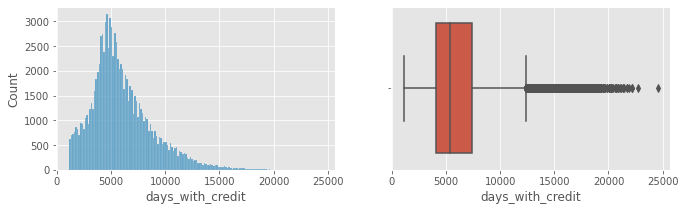

In [25]:
fig, ax = plt.subplots(1,2,figsize=(11,3))
sns.histplot(x = data['days_with_credit'],ax=ax[0])
sns.boxplot(x = data['days_with_credit'],ax=ax[1])

In [26]:
data['days_with_credit'].describe()

count    100000.000000
mean       5991.028900
std        2846.227732
min        1124.000000
25%        4110.000000
50%        5417.000000
75%        7427.000000
max       24531.000000
Name: days_with_credit, dtype: float64

last_fico (latest FICO score) and overall_fico (overall FICO score) are a consolidation of other FICO score columns provided. last_fico is the latest FICO score of the main applicant, while overall_fico is the average FICO score, which includes the secondary applicant's score if applicable. Obviously, FICO score is another major consideration of a borrower's lending risk, and the score itself includes many other factors. Interestingly, we can see from the boxplots below, when there is a secondary applicant involved, the principle applicant who already has a high FICO score gets averaged into a slightly lower range. The median for the principle applicant is over 700, while the overall median, which takes into consideration the secondary applicant when applicable, is below 700. By combining scores of both principle and secondary applicants, the interquartile range and min to max range both became tighter. For _overall FICO_ score, the average of two applicants is rarely above 780 (most are considered outliers on the plot). For both _last FICO_ score and _overall FICO_ score, the majority of applicants seem to be over 650; in other words, it is hard to get approved for a loan with credit score of 650 and below at LendingClub.

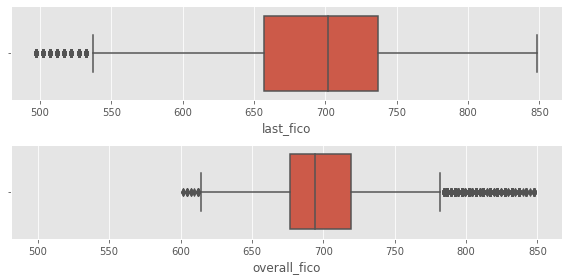

In [27]:
fig, ax = plt.subplots(2,1,figsize=(8,4))
sns.boxplot(x = data['last_fico'],ax=ax[0])
sns.boxplot(x = data['overall_fico'], ax=ax[1])
plt.xlim(481, 867)
plt.tight_layout()
plt.show()

In [28]:
# Joint plot data 
joint_data_df = data.copy(deep=False)      
joint_data_filtered_revol_bal_df = joint_data_df[(joint_data_df['revol_bal'] >= 1000) 
                                                 & (joint_data_df['revol_bal'] <= 100000)]

Text(0.5, 0.98, 'Last Fico Score vs Interest Rate of Loan')

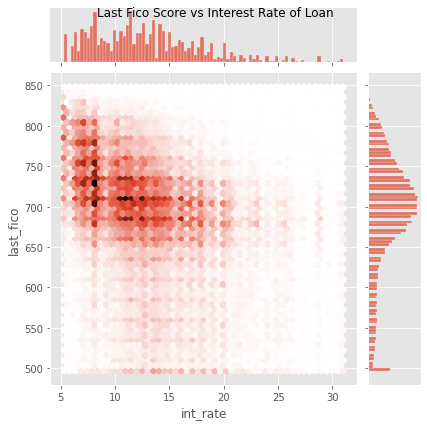

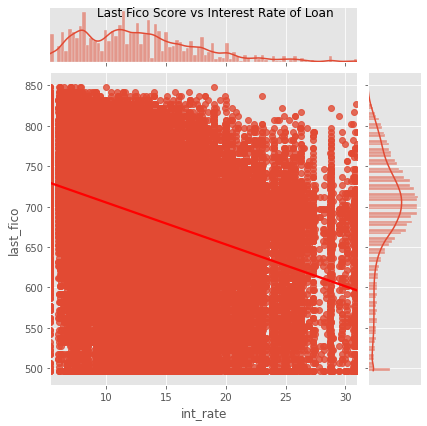

In [29]:
# Last Fico Score vs Interest Rate
sns.jointplot(x='int_rate',y='last_fico',data=joint_data_df,kind='hex')
plt.suptitle("Last Fico Score vs Interest Rate of Loan")

sns.jointplot(x='int_rate',y='last_fico',data=joint_data_df,kind='reg', joint_kws={'line_kws':{'color':'red'}})
plt.suptitle("Last Fico Score vs Interest Rate of Loan")

Although there are many interest rates and FICO scores in our dataset, as seen above, an individual with a lending club loan's last FICO Score appears to be negatively correlated to interest rate. This makes intuitive sense because a lender who would grant a loan, would need to make riskier loans more profitable to make up for the loss associated with the increased rate of defaulting. A FICO score is built to predict how likely an individual is to pay back a credit, so the relationship with Lending Club grade is logical. Both joint plots above give us a direct visual of the relationship between the two variables of interest. And the histograms on the side highlight the distribution of each variable. As can be seen, the confidence intervals for a predicted population mean are very narrow. This is because we are using a large dataset to perform our linear regression. 


https://www.investopedia.com/terms/f/ficoscore.asp 

Text(0.5, 0.98, 'Pairs Regression Lines for Total Bank Card Utilization, Revolving Balance, Revolving Utilization, and Total Bank Card Limit')

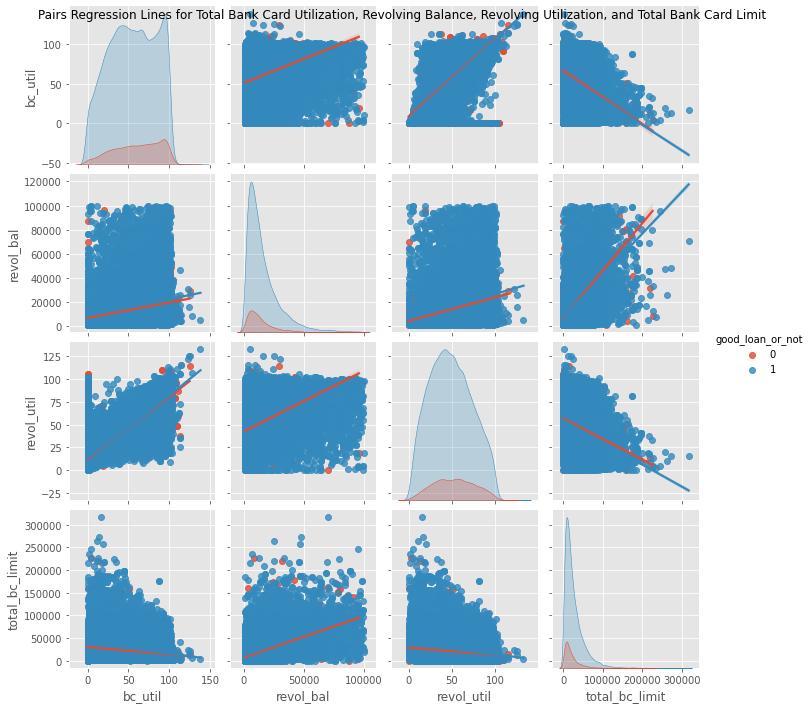

In [30]:
# Pairs Plots
joint_data_filtered_revol_bal_sub_sample_df = joint_data_filtered_revol_bal_df.sample(frac=0.5, replace=True, random_state=1)
sns.pairplot(joint_data_filtered_revol_bal_sub_sample_df[['bc_util', 'revol_bal', 'revol_util', 'total_bc_limit', 'good_loan_or_not']], hue="good_loan_or_not", kind="reg")
plt.suptitle("Pairs Regression Lines for Total Bank Card Utilization, Revolving Balance, Revolving Utilization, and Total Bank Card Limit")

After we filter out all revolving credit balances of 0 (no rolling debt for the loaner) we can see that there are direct relationships between Total Bank Card Utilization, Revolving Balance, Revolving Utilization percentage and Total Bank Card Limit. These properties are all moderately or heavily correlated with one another.  This makes sense if you think about it. Scatter plots with linear regression lines, with confidence intervals highlight the linear correlation between the variables in a visually interpretable way. The Kernel density plots, colorized by whether or not a loan was good are along the diagonal axis, which highlights potential separability of each variable. The following relationships exist between Total Bank Card Utilization, Revolving Balance, Revolving Utilization percentage and Total Bank Card Limit: 

#### Total Bank Card Utilization Vs. Revolving Balance: 
We can see that there is a moderately strong positive correlation between these two attributes. This makes sense because Revolving Balance represents the outstanding balance that rolls over for a loaner where as the Total Bank Card Utilization represents the percentage of a credit line that a given loaner has used. When the Bank Card Utilization (Credit line) is used more heavily, the amount that loaners are able to pay back in a given pay period (Month) likely goes down. 
    
#### Total Bank Card Utilization Vs. Revolving Utilization Percentage:   
There is a strong positive linear correlation between Revolving Utilization and Bank Card Utilization. This makes obvious sense as the two are by definition linked. As the revolving utilization of a credit line goes up for a loaner, so too does their overall percentage owed. Although these aren't perfectly correlated a loaner might have a high revolving utilization for a particular time frame, which still might be an overall small percentage of their total allowed credit, there is a strong correlation between these two attributes. The bottom line is these two properties can actually be thought of as fairly redundant. 
 
#### Total Bank Card Utilization Vs. Total Bank Card Limit: 
We can see that Total Bank Card Limit does appear to have a negative linear correlation with Total Bank Card Utilization. This could be due to a variety of reasons. For example, as the total credit limit goes up for a borrower, it is possible that they actually need the loan less because they are doing better financially. In other words, the lender is willing to allow them a higher credit limit because they are less of a risk. 
 
#### Revolving Balance Vs. Revolving Utilization Percentage:  
There is another strong positive correlation between Revolving balance and Revolving Utilization Percentage. This makes sense as the two represent very similar metrics (one is a percentage and one is a dollar amount). The only reason it isn't a pure 1:1 correlation, is that the revolving utilization includes the total balance in its calculation. These properties can be thought of as functionally redundant.  
 
#### Revolving Balance Vs. Total Bank Card Limit:  
Total Bank Card Limit does seem to have a moderately strong positive linear correlation to revolving balance. This is interesting because it means that the more rolling debt a loaner has,  on average, the more credit the lender is willing to let them have. This might be explained simply as a matter of scale. In other words a million dollar loan has higher payments, and in the case of a loaner not making full payments every payment period, that higher loan, with its higher payments, would carry a higher amount of rollover to the next payment period.  


#### Revolving Utilization Percentage Vs. Total Bank Card Limit:
Very similar to Total Bank Card Utilization Vs. Total Bank Card Limit, We can see that Revolving Utilization Percentage appears to have a negative linear correlation with Total Bank Card Utilization. This could be due to a variety of reasons. Again, Revolving Balance and Revolving Utilization Percentage are highly redundant so this makes sense. 

# Modeling and Evaluation 1: Train and Adjust Parameters

#### Subset Data

Because preliminary attempts at cluster analysis were very time and resource intensive, we chose to randomly subset the 100,000 instances down to 40,000. This allowed us to tune hyperparameters in a more efficient manner. 

In [2]:
path = f"{d}/data/loan_100k_sample0709.pkl"
%time data = joblib.load(path)
data = data.sample(frac=0.40, replace=True, random_state=1)

CPU times: user 87.1 ms, sys: 44 ms, total: 131 ms
Wall time: 130 ms


#### Define Helper Functions: prepare dataset for predicting good_loan_or_not

In [3]:
def drop_variables(data, drop_vars):
    # Drop variables that perfectly colinears with good_loan_or_not
    
    temp_data = data.drop(drop_vars,axis=1)
    # Drop only observation with home_ownership = 'NONE'
    temp_data.drop(temp_data[temp_data['home_ownership']=='NONE'].index,inplace=True,axis=0)
    return temp_data
    
def prepare_x_y(data, response):
    # Create X y variables with addr_state excluded
    # good_loan_or_not is response, and it derives from loan_status
    # issue_d, earliest_cr_line, and last_pymnt_d are dates format and they are
    # converted into other formats to be useful
    # int_rate collinear with grade, we decided to keep grade
    X, y = data.drop([response], axis=1), data[response]
    
    if response == "grade":
        y = y.apply(lambda x: consolidate_grade(x))
        
    return X, y

def get_indexes (X):
    categorical_col = X.select_dtypes(include=['object', 'bool']).columns
    numeric_col = X.select_dtypes(include=['float','int']).columns
    # Create function to extract column index
    def get_col_index(col_names):
        col_list = []
        for col_name in col_names:
            col_list.append(X.columns.get_loc(col_name))
        return col_list
    categorical_ix = get_col_index(categorical_col)
    numeric_ix = get_col_index(numeric_col)
    return categorical_col, numeric_col, categorical_ix, numeric_ix

# convert grade A,B,C,D,E,F,G into A,B,C,D,E-G
def consolidate_grade(x: str):
    if x in ['E','F','G']:
        return 'E-G'
    else:
        return x

def get_train_test_dataset(data, drop_vars, response):
    data = data
    data = drop_variables(data, drop_vars)
    # choose x and y
    X, y = prepare_x_y(data, response)
    # train test split 
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=101, stratify=y)
    categorical_col, numeric_col, categorical_ix, numeric_ix = get_indexes(X)
    
    return X_train, X_test, y_train, y_test, categorical_col, numeric_col, categorical_ix, numeric_ix

# Categories to drop - good_loan_or_not
reference_levels_to_drop = [
    [' 36 months'],
    ['A'],
    ['< 1 year'],
    ['ANY'],
    ['Not Verified'],
    ['other'],
    ['Individual'],
    ['N']
]


### Further Data Cleaning: Remove Variables for clustering and prediction
We removed the following additional variables because they were not needed or not useful for our analysis.  

__Occur after loan is complete:__  

`debt_settlement_flag`, `recoveries`, `total_rec_late_fee`, `delinq_amnt`: Further exploratory data analysis for this project illustrated that these four variables are nearly perfect predictors for bad loan. They each occurred only when a loan is already late or charged off. We decided these would not be practical from a prediction standpoint. Our goal was to predict a bad outcome before it happens, and these only occur afterwards.  

`out_prncp`, `total_rec_princp`: These two variables, in combination with `total_loan_amnt`, almost perfectly predicted loan outcome. When `total_rec_princp` was equal to the total loan, the loan had been fully paid. When `total_rec_princp` plus `out_prncp` was equal to the total loan, it was current. However, when the combination of the two did not equal the total loan, the loan was charged off (bad status). This was because `out_prncp` was set to zero once the charge off occurred. This information was not useful from a prediction standpoint because it would only be available after a loan was fully paid or a charge off occurred.

__Not needed or useful:__  

`issue_d`, `earliest_cr_line`, `last_pymnt_d`: These variables are dates and are not useful in their current format for this analysis.  

`int_rate`: `grade` determines `int_rate` so we removed it and retained `grade`.  

`addr_state`: Our exploratory data analysis indicated that the home state of the loan applicant did not have a strong relationship with loan outcome. We decided the additional 50 levels it would have added to the model were not necessary for a variable with little relationship to the outcome.  

Additionally, we removed one instance because it was the only instance of `home_ownership` with a value of "none."

`loan_status`: This variable was used to build our response variable (`good_loan_or_not`) so it was necessary to remove it from the explanatory variables.  

We removed `good_loan_or_not` from our loan outcome explanatory variables because it is the response we are predicting.  


In [4]:
# set variables to drop
drop_vars = ["debt_settlement_flag","recoveries","total_rec_late_fee","delinq_amnt","out_prncp","total_rec_prncp", 
             "addr_state","loan_status","issue_d","earliest_cr_line","last_pymnt_d","int_rate"]

X_train, X_test, y_train, y_test, categorical_col, numeric_col, categorical_ix, numeric_ix = \
                get_train_test_dataset(data, drop_vars, "good_loan_or_not")

In [5]:
# Define report function
def get_acc_score(model, x, y):
    return model.score(x, y)

def get_auc(y_test, pred):   
    fpr, tpr, _ = roc_curve(y_test, pred, pos_label=1)
    roc_auc = auc(fpr, tpr)
    return roc_auc
  
def plot_roc_curve_custom(y_test, yPred):
    fpr, tpr, _ = roc_curve(y_test, yPred)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label='Randomized Search CV (AUC = ' + str(round(roc_auc, 5)) + ')')
    plt.legend(loc='lower right')
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
def get_classification_report(x_train, y_train, x_test, y_test, pred, model):
    """
    This function is used to get comprehensive classification report:
    Training Accuracy, Test Accuracy, print classification_report
    plot confusion matrix, and plot roc curve.
    """
    print(f"Train accuracy: {get_acc_score(model, x_train, y_train):,.5f}")
    print("Test result:")
    print(classification_report(y_test,pred))
    plot_roc_curve_custom(y_test, pred)
    plot_confusion_matrix(model, x_test, y_test,colorbar=False)
    plt.grid(None)
#     plot_roc_curve(model, x_test,y_test, response_method="predict_proba")
    fpr, tpr, thresholds = roc_curve(y_test, pred, pos_label=1)
    print(f"Test AUC: {auc(fpr, tpr):,.5f}")
def cv_common(df, columns):
    cv_result_summary = df[columns]
    cv_result_summary.index  = np.arange(1,len(cv_result_summary)+1)
    cv_result_summary = cv_result_summary.reset_index()
    return cv_result_summary
    

def cv_summary(estimator, columns):
    df = pd.DataFrame(estimator.cv_results_)
    cv_result_summary = cv_common(df, columns)
    cv_result_summary = cv_result_summary.rename(columns = {
        "index": "param_combination"
    })
    return cv_result_summary
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)

#### Method for Dividing Data

The function `get_train_test_dataset`, which we defined above, is a helper function to divide our dataset into 80% training (later used for 10 fold cross validation), and 20% test set for testing the best algorithm selected from cross validation on unseen data (model evaluation for future performance). We employed a random_state to make sure our work is reproducible and we used stratify=y, because the response variable `good_loan_or_not` is somewhat imbalanced. Stratification ensures our training data contains the original imbalance ratio from the full dataset, and we can take corresponding measures such as addressing class_weight = "balanced" to better address the imbalance through training samples extracted.

#### Cross-validation

We defined our cross validation method `cv` as StratifiedKFold to address the imbalance issue mentioned above through each cross validation. Stratification assures our training data contains the original imbalance ratio from the larger dataset. We set shuffle = True to shuffle each class's sample before splitting into batches. This will generate more randomness through the cross validation process. We further set random_state=1 to make sure our work is reproducible.

We defined `cv_summary` to print out cross validation results during the grid search to compare cross validation results between different parameter combinations.

In [6]:
def save_load(save, name, model=None):
    file_name = f"{cwd}/pickle_models/{name}.sav"
    if save:
        joblib.dump(model, file_name)
        return None
    else:
        
        return joblib.load(file_name)

In [7]:
def get_train_auc(X_train, y_train, estimator):
    return estimator.score(X_train, y_train)

def add_text(df,  model_type):
    if model_type == "lr":
        df['text'] = "Params Combination: #" + df.param_combination.astype(str) + "; Estimator Rank: " +df.rank_validation_score.astype(str) + ";Solver: " + df.param_model__solver.astype(str) \
        + " Penalty: " + df.param_model__penalty.astype(str) +  " C: " + df.param_model__C.astype(str) + " Intercept Fit: " + df.param_model__fit_intercept.astype(str) 
    elif model_type == "lr_cluster": 
         df['text'] = "CV Iter:" + df.param_combination.astype(str) + "; Estimator Rank: " +df.rank_validation_score.astype(str) + ";features__clustering__kmeans__n_clusters: " + df.param_features__clustering__kmeans__n_clusters.astype(str)
    elif model_type == "kmeans": 
         df['text'] = "CV Iter:" + df.param_combination.astype(str) + "; Estimator Rank: " +df.rank_validation_score.astype(str)
    elif model_type == "birch": 
         df['text'] = "CV Iter:" + df.param_combination.astype(str) + "; Estimator Rank: " +df.rank_validation_score.astype(str)
    elif model_type == "spectral": 
         df['text'] = "CV Iter:" + df.param_combination.astype(str) + "; Estimator Rank: " +df.rank_validation_score.astype(str)
    elif model_type == "gm": 
         df['text'] = "CV Iter:" + df.param_combination.astype(str) + "; Estimator Rank: " +df.rank_validation_score.astype(str)
    return df


def plot(df, name):
    fig = make_subplots(
            rows=1, cols=2,
            subplot_titles = ("Mean Fit Time (Seconds)", "Mean CV Train/Validation Score (AUC)"))

    fig.add_trace(
        go.Scatter(y=df.mean_fit_time, x=df.param_combination),
        row=1, col=1)

    fig.add_trace(
        go.Scatter(y=df.mean_train_score, x=df.param_combination, opacity = 0.5, name="Train"),
        row=1, col=2
    )
    fig.append_trace(
        go.Scatter(y=df.mean_validation_score, x=df.param_combination, opacity = 0.5, name="Validation"),
        row=1, col=2
    )
    fig.update_traces(textposition='top center')
    fig.update_layout(showlegend=False, title_text=f"{name} Performance and Efficiency")
    fig.add_annotation(y=df[df["rank_validation_score"]==1].mean_fit_time.values[0], text="Best Fitted", x=df[df["rank_validation_score"]==1].param_combination.values[0])
    fig['layout']['xaxis']['title']='Hyperparameter Combinations'
    fig['layout']['yaxis']['title']='Seconds'
    fig['layout']['xaxis2']['title']='Hyperparameter Combinations'
    fig['layout']['yaxis2']['title']='AUC'
    #fig['layout']['annotations'][2].update(text="Best Fitted", x=df[df["rank_test_score"]==1].param_combination.values[0])
    fig.show()
    
    
    display(HTML(f"<h5>Best fit CV Validation AUC: {df[df['rank_validation_score']==1].mean_validation_score.values[0] * 100:.2f}"))
    #display(HTML(f"<H5>Train AUC: {train_auc} </H5>"))
    display(HTML(f"<H5>Params Combinations Average 10-Fold CV Training time: {convert(df.mean_fit_time.mean())} </H5>"))
    display(HTML("<br> <h3>Hyper Parameter Combination Table: </h3>"))
    display(HTML(df.drop(["text"], axis=1).to_html(index=False) ))
   
    
    

    # function copied from https://www.geeksforgeeks.org/python-program-to-convert-seconds-into-hours-minutes-and-seconds/
def convert(seconds):
    seconds = seconds % (24 * 3600)
    hour = seconds // 3600
    seconds %= 3600
    minutes = seconds // 60
    seconds %= 60
      
    return "%d:%02d:%02d" % (hour, minutes, seconds)
      

def make_bar_plot(mean_scores, title):
    mean_scores = pd.DataFrame.from_dict(mean_scores, orient="index").reset_index()
    mean_scores = mean_scores.rename(columns={0: "AUC", "index": "Best Estimator"})
    fig = px.bar(mean_scores, x='Best Estimator', y="AUC", title=title)
    fig.add_annotation(text = f'AUC: {mean_scores[mean_scores["Best Estimator"]=="Not Scaled Logistic Regression"].AUC.values[0]:.5f}', x="Not Scaled Logistic Regression",y=40)
    fig.add_annotation(text = f'AUC: {mean_scores[mean_scores["Best Estimator"]=="Scaled Logistic Regression"].AUC.values[0]:.5f}', x="Scaled Logistic Regression",y=40)
    fig.add_annotation(text = f'AUC: {mean_scores[mean_scores["Best Estimator"]=="Support Vector Machine"].AUC.values[0]:.5f}', x="Support Vector Machine",y=40)
    fig.show()

def make_bar_plot_per_model(df, title):
    df  = pd.DataFrame.from_dict(df, orient="index").reset_index()
    df = df.rename(columns={0: "AUC", "index": "Dataset"})
    fig = px.bar(df, x='Dataset', y="AUC", title=title)
    fig.add_annotation(text = f'AUC: {df[df["Dataset"]=="Mean CV Train"].AUC[0]:.5f}', x="Mean CV Train",y=85)
    fig.add_annotation(text = f'AUC: {df[df["Dataset"]=="Mean CV Validation"].AUC[1]:.5f}', x="Mean CV Validation",y=85)
    fig.add_annotation(text = f'AUC: {df[df["Dataset"]=="Test"].AUC[2]:.5f}', x="Test",y=85)
    fig.update_yaxes(range=[50,100])
    fig.show()
    

def cv_common(df, columns):
    cv_result_summary = df[columns]
    cv_result_summary.index  = np.arange(1,len(cv_result_summary)+1)
    cv_result_summary = cv_result_summary.reset_index()
    return cv_result_summary
    

def cv_summary(estimator, columns):
    df = pd.DataFrame(estimator.cv_results_)
    cv_result_summary = cv_common(df, columns)
    cv_result_summary = cv_result_summary.rename(columns = {
        "index": "param_combination", "mean_test_score": "mean_validation_score",
        "rank_test_score": "rank_validation_score"
    })
    return cv_result_summary

def get_auc(y_test, pred):
    
    fpr, tpr, _ = roc_curve(y_test, pred, pos_label=1)
    roc_auc = auc(fpr, tpr)
    return roc_auc

#### Final Dataset for Modeling and Evaluation

The final training set contains 32,000 training instances and 8,000 testing instances.

In [8]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32000 entries, 37499 to 41352
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   32000 non-null  float64
 1   term                        32000 non-null  object 
 2   grade                       32000 non-null  object 
 3   emp_length                  32000 non-null  object 
 4   home_ownership              32000 non-null  object 
 5   annual_inc                  32000 non-null  float64
 6   verification_status         32000 non-null  object 
 7   purpose                     32000 non-null  object 
 8   dti                         32000 non-null  float64
 9   delinq_2yrs                 32000 non-null  float64
 10  inq_last_6mths              32000 non-null  float64
 11  open_acc                    32000 non-null  float64
 12  revol_bal                   32000 non-null  float64
 13  revol_util                 

In [9]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8000 entries, 61377 to 52223
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   8000 non-null   float64
 1   term                        8000 non-null   object 
 2   grade                       8000 non-null   object 
 3   emp_length                  8000 non-null   object 
 4   home_ownership              8000 non-null   object 
 5   annual_inc                  8000 non-null   float64
 6   verification_status         8000 non-null   object 
 7   purpose                     8000 non-null   object 
 8   dti                         8000 non-null   float64
 9   delinq_2yrs                 8000 non-null   float64
 10  inq_last_6mths              8000 non-null   float64
 11  open_acc                    8000 non-null   float64
 12  revol_bal                   8000 non-null   float64
 13  revol_util                  

### Train and Adjust Parameters

The following section explores KMeans clustering, Birch clustering, Spectral clustering, and Gaussian Mixtures. We chose to cluster the numeric variables and exclude the categorical variables because methods such as KMeans use distance metrics that are only appropriate for numeric variables. In order to compare the effectiveness of different clustering techniques as a preprocessing method, consistency was required, so we used only numeric variables with each method and then used logistic regression for classification with each.

We used a pipeline to scale the numeric variables, then cluster analyze, and finally fit a logistic regression predicting loan outcome.  

For predicting the good_loan_or_not variable, we chose to use high precision for both outcomes to evaluate the overall model performance. Since our class labels are imbalanced, in order to achieve this, we selected scoring="roc_auc", area under the curve to evaluate models during cross validation. This is a binary classification problem, and our end goal is to predict good loans and bad loans equally well. Best area under the curve generally selects the model that carries the highest true positive rate as well as the lowest false positive rate. Considering we have an unbalanced dataset, this scoring metric would give each label (good loans or bad loans) a fair chance to both be selected to have high precision. 

#### Tune Hyperparameters

__KMeans__  
For KMeans Clustering, we used grid search to compare models with different values of the parameter n_clusters. n_clusters adjusts the number of clusters formed. param_grid contains the different values for n_clusters.  <a href="https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html">sklearn.cluster.KMeans</a>

__Birch__  
For Birch Clustering, we used grid search to compare models with different values of the parameters branching_factor, threshold, and ncluster. Threshold adjusts the maximum radius of a subcluster made by merging a new sample and the nearest subcluster. If the radius is equal to or greater than the threshold, a new subcluster is formed. branching_factor adjusts the maximum number of CF subclusters in each node. ncluster adjusts the number of clusters after the final clustering step. grid_birch contains the different values for each of these parameters.  <a href="https://scikit-learn.org/stable/modules/generated/sklearn.cluster.Birch.html">sklearn.cluster.Birch</a>

__Spectral__  
For Spectral Clustering, we used grid search to compare models with different values of the parameter n_neighbors. n_neighbors adjusts the number of neighbors used when constructing the affinity matrix. grid_spectral_lr contains the different values for n_neighbors. <a href="https://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html">sklearn.cluster.SpectralClustering</a> 

Note: During initial exploration of spectral clustering models, we also tuned the parameter n_clusters, which adjusts the dimension of the projection subspace. However, tuning this parameter did not change the validation AUC score. As addressed below, spectral clustering is very resource intensive, so we chose to only tune n_neighbors for our final spectral model because it had an effect on the validation scores.

__Gaussian Mixtures__  
For Gaussian Mixtures, we used grid search to compare models with different values of the parameters n_init and n_components. n_init adjusts the number of initializations to perform. n_components adjusts the number of mixture components.  <a href="https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html#sklearn.mixture.GaussianMixture">sklearn.mixture.GaussianMixture</a>



### KMeans Clustering with only numeric variables + Logistic Regression

We utilized Pipeline to incorporate scaling of the numeric variables, KMeans clustering, and the logistic regression model. We used GridSearchCV to evaluate each parameter defined above through a 10-fold cross validation on the training data. We chose area under the curve (roc_auc) for performance evaluation because we wanted to maximize the precision of predicting both good loans and bad loans. The best parameter was then selected using roc_auc score and was fitted to our training data under the variable "search_kmeans." We evaluate this model's performance on the test set in the next section.

In [8]:
# Define preprocessing for kmean clustering 
t_kmean = [('scale',StandardScaler(), numeric_ix)]
col_transform_num = ColumnTransformer(t_kmean, remainder='drop')
# Define Model and pipeline for trying kmeans
pipeline_kmeans = Pipeline(steps=[
    ('preprocessing',col_transform_num),
    ("kmeans", KMeans(n_clusters=200, random_state=101)),
    ("log_reg", LogisticRegression(class_weight='balanced',max_iter=15000,random_state=111))
])
# Tune parameters of n_clusters to train
param_grid = dict(kmeans__n_clusters = [50,100,200,300,350])

In [9]:
%%time
grid_clf_kmean = GridSearchCV(pipeline_kmeans, param_grid, cv=cv,scoring='roc_auc', verbose=15, 
                              n_jobs=-1,return_train_score=True)
search_kmeans = grid_clf_kmean.fit(X_train,y_train)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
CPU times: user 22min 29s, sys: 1min 48s, total: 24min 17s
Wall time: 33min 1s


### Birch Clustering with only numeric variables + Logistic Regression  

Because using Pipeline requires a transform for intermediate steps, and the Birch algorithm does not transform new data, we created a custom BirchTransformer based on BaseEstimator and TransformerMixin. This allowed us to utilize Pipeline to incorporate the scaling of the numeric variables, Birch clustering, and the logistic regression model. We used GridSearchCV each parameter combination defined above through a 10-fold cross validation on the training data. We chose area under the curve (roc_auc) for performance evaluation because we wanted to maximize the precision of predicting both good loans and bad loans. The best combination of parameters was then selected using roc_auc score and was fitted to our training data under the variable "search_birch." We evaluate this model's performance on the test set in the next section.

In [8]:
class BirchTransformer(BaseEstimator,TransformerMixin):
    def __init__(self, threadshold=1.5, branching_factor=500, n_clusters=50):
        self.threadshold = threadshold
        self.branching_factor = branching_factor
        self.n_clusters = n_clusters
        
    def fit(self, X, y=None):
        self.pipeline = Pipeline(steps=[
            ('preprocessing',ColumnTransformer([('scale',StandardScaler(), numeric_ix)], remainder='drop')),
            ("birch", Birch(threshold=self.threadshold, branching_factor=self.branching_factor, n_clusters=self.n_clusters))
        ])
        self.column_transform = ColumnTransformer([('cat', OneHotEncoder(), [0])],remainder='passthrough')
        birch_labels = self.pipeline.fit_predict(X)
        birch_df = pd.DataFrame(birch_labels)
        self.column_transform.fit(birch_df)
        return self
    
    def transform(self, X, y=None):
        birch_labels = self.pipeline.predict(X)

        birch_df = pd.DataFrame(birch_labels)
        return self.column_transform.transform(birch_df)

In [9]:
# Define Birch Pipeline
birch_pipe = Pipeline(steps=[
    ('preprocessing',BirchTransformer()),
    ('model', LogisticRegression(class_weight='balanced',max_iter=15000,random_state=111))
])
# Define Grid to tune
grid_birch = {
    "preprocessing__branching_factor":[300,500],
    "preprocessing__threadshold":[1.5,3],
    "preprocessing__n_clusters":[50,100]
    
}

In [10]:
%%time
search_grid_birch = GridSearchCV(birch_pipe,grid_birch, cv=cv,scoring='roc_auc',
                                n_jobs=10, verbose=15, return_train_score=True)
search_birch = search_grid_birch.fit(X_train,y_train)

Fitting 10 folds for each of 8 candidates, totalling 80 fits
CPU times: user 58.5 s, sys: 18.5 s, total: 1min 17s
Wall time: 8min 16s


### Spectral Clustering with only numeric variables + Logistic Regression  

Because using Pipeline requires a transform for intermediate steps, and the Spectral algorithm does not transform new data, we created a custom SpectralClusteringWithKNNClassifier based on BaseEstimator and TransformerMixin. In order to predict new test data for Spectral Clustering, we also built a KNN classifier into this custom function. We utilized Pipeline to incorporate the scaling of the numeric variables, Spectral clustering, and the logistic regression model. We used GridSearchCV to evaluate each parameter defined above through a 10-fold cross validation on the training data. We chose area under the curve (roc_auc) for performance evaluation because we wanted to maximize the precision of predicting both good loans and bad loans. The best parameter was then selected using roc_auc score and was fitted to our training data under the variable "search_spectral." We evaluate this model's performance on the test set in the next section.

In [8]:
# todo: try different affinities?  
class SpectralClusteringWithKNNClassifier(BaseEstimator,TransformerMixin):
    def __init__(self,
                 n_clusters=20,
                 n_components=20,
                 random_state=0,
                 n_neighbors=3,
                 assign_labels='discretize'):      
        self.n_clusters = n_clusters
        self.n_components = n_components
        self.random_state = random_state
        self.n_neighbors = n_neighbors
        self.assign_labels = assign_labels
        self.knn_neighbors = 3

    def fit(self, X, y=None):
        if not type(X) is np.ndarray:
           raise ValueError("Must have type numpy.ndarray to use this transformer!")
        self.cluster_clf = Pipeline([
            ('scaler', StandardScaler()), # This is probably redundant
            ('knn', KNeighborsClassifier(n_neighbors=self.knn_neighbors))
        ])
        self.spectral_clustering_model = SpectralClustering(
            n_clusters=self.n_clusters,
            n_components=self.n_components,
            random_state=self.random_state,
            affinity='nearest_neighbors',
            assign_labels=self.assign_labels,
            n_neighbors=self.n_neighbors)

        spectral_labels = self.spectral_clustering_model.fit_predict(X)
        self.cluster_clf.fit(X, spectral_labels)
        return self
    
    def transform(self, X, y=None):
        spectral_labels = self.cluster_clf.predict(X)
        # I'm not crazy about returning a dataframe, this seems inefficient. 
        #@David maybe there is a way we can use np.ndarray? 
        return pd.DataFrame(spectral_labels)

In [9]:
spectral_pipe = Pipeline(steps=[
    ('preprocessing',ColumnTransformer([('scale',StandardScaler(), numeric_ix)], remainder='drop')),
    ('clustering', SpectralClusteringWithKNNClassifier()),
    ('encoding',  ColumnTransformer([
        ('cat', OneHotEncoder(), [0])], 
        remainder='passthrough')),
    ('model', LogisticRegression(class_weight='balanced',max_iter=15000,random_state=111))
])

# Define Grid Search
grid_spectral_lr = {
    "clustering__n_clusters":[50],
    "clustering__n_neighbors":[10,15,20]
}

In [10]:
%%time
search_grid_spectral = GridSearchCV(spectral_pipe, grid_spectral_lr, cv=cv, scoring='roc_auc',
                                n_jobs=10, verbose=15, return_train_score=True)    
search_spectral = search_grid_spectral.fit(X_train,y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits
CPU times: user 3h 39min 28s, sys: 36min 50s, total: 4h 16min 18s
Wall time: 7h 32min 53s


### Gaussian Mixtures with only numeric variables + Logistic Regression  

Because using Pipeline requires a transform for intermediate steps, and the Gaussian Mixtures algorithm does not transform new data, we created a custom GausianMixtureTransformer based on BaseEstimator and TransformerMixin. This allowed us to utilize Pipeline to incorporate the scaling of the numeric variables, Gaussian Mixtures, and the logistic regression model. We used GridSearchCV each parameter combination defined above through a 10-fold cross validation on the training data. We chose area under the curve (roc_auc) for performance evaluation because we wanted to maximize the precision of predicting both good loans and bad loans. The best combination of parameters was then selected using roc_auc score and was fitted to our training data under the variable "search_gm." We evaluate this model's performance on the test set in the next section.

In [8]:
# todo: try different affinities?  
class GausianMixtureTransformer(BaseEstimator,TransformerMixin):
    def __init__(self,
                 n_components=20,
                 covariance_type = 'full',
                 random_state=0,
                 n_init = 1):
        self.n_components = n_components
        self.covariance_type = covariance_type
        self.random_state = random_state
        self.n_init = n_init
        
    def fit(self, X, y=None):
        if not type(X) is np.ndarray:
           raise ValueError("Must have type numpy.ndarray to use this transformer!")
        
        self.gm_model = GaussianMixture(
            n_components=self.n_components,
            covariance_type=self.covariance_type,
            random_state=self.random_state,
            n_init = self.n_init)
        
        self.gm_model.fit(X)
        return self
    
    def transform(self, X, y=None):
        gm_labels = self.gm_model.predict(X)
        # I'm not crazy about returning a dataframe, this seems inefficient. 
        #@David maybe there is a way we can use np.ndarray? 
        return pd.DataFrame(gm_labels) 

In [9]:
gm_pipe = Pipeline(steps=[
    ('preprocessing',ColumnTransformer([('scale',StandardScaler(), numeric_ix)], remainder='drop')),
    ('clustering', GausianMixtureTransformer()),
    ('encoding',  ColumnTransformer([
        ('cat', OneHotEncoder(), [0])], 
        remainder='passthrough'))
])

gm_lr_pipeline = Pipeline([
   ("clustering", gm_pipe), 
   ('model', LogisticRegression(class_weight='balanced',max_iter=15000,random_state=111)) 
])

# Define Grid Search
grid_gm_lr = {
    "clustering__clustering__n_init":[1,2],
    "clustering__clustering__n_components":[50,100,150]
} 

In [10]:
%%time
grid_search_gm = GridSearchCV(gm_lr_pipeline, grid_gm_lr, cv=cv, scoring='roc_auc',
                                n_jobs=-1, verbose=15, return_train_score=True) 
search_gm = grid_search_gm.fit(X_train, y_train)

Fitting 10 folds for each of 6 candidates, totalling 60 fits
CPU times: user 36min 11s, sys: 7min 34s, total: 43min 45s
Wall time: 1h 36min 23s


# Modeling and Evaluation 2: Evaluate and Compare  

#### Overview


As seen from the results below, for predicting loan outcome, the test AUC for the 4 best-fitted estimators ranges from 57.73% to 91.92%. The model with the highest AUC score is the KMeans clustering with logistic regression (91.92%). This is followed by the Birch clustering with logistic regression (68.61%). Next is Spectral Clustering with logistic regression (64.55%), and finally Gaussian Mixtures with logistic regression (57.73%).  

The model using KMeans clustering as a preprocessing method produces the best results by a wide margin. 



| Model | Best Mean Train Score | Best Mean Validation Score | Test AUC |
| --- | --- |---|---|
| KMeans + Logistic | 96.99% |96.51%|91.92%|
| Birch + Logistic | 77.46% |75.81%|68.61%|
| Spectral + Logistic | 66.44% |66.08%|64.55%|
| Gaussian Mixtures + Logistic | 64.80% |61.66%|57.73%|



Training Time

The time needed to train each of the models varied widely, ranging from 8 minutes 16 seconds, in the case of Birch clustering, to over 7 hours for Spectral clustering. 

| Model | Mean Training Time per Fold | Total Training Time|
| --- | --- | ---|
| KMeans + Logistic | 8min 21sec |24mins 17sec|
| Birch + Logistic | 46sec |8mins 16 sec|
| Spectral + Logistic | 2h 12min 28sec |7hr 32min|
| Gaussian Mixtures + Logistic | 21min 43sec | 1hr 36 min|

### KMeans Clustering with only numeric variables + Logistic Regression

In [19]:
# save_load(True,"kmeans_lr_3",search_kmeans)
search_kmeans = save_load(False,"kmeans_lr_3")

In [20]:
yhat_kmeans = search_kmeans.predict(X_test)

In [21]:
best_kmeans_columns = ['param_kmeans__n_clusters','mean_train_score', 'mean_test_score','rank_test_score']
kmeans_summary = cv_summary(search_kmeans,best_kmeans_columns)

kmeans_cluster_model= {
    "Mean CV Train": kmeans_summary[kmeans_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": kmeans_summary[kmeans_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, yhat_kmeans)*100
}
kmeans_summary

,param_combination,param_kmeans__n_clusters,mean_train_score,mean_validation_score,rank_validation_score
0,1,50,0.959738,0.958789,5
1,2,100,0.964405,0.962587,4
2,3,200,0.967692,0.963876,3
3,4,300,0.969260,0.964601,2
4,5,350,0.969915,0.965113,1


For this model, the best mean train/validation scores (train:0.969915, validation: 0.965113) came from parameter combination #5. The combination used n_clusters = 350 when conducting KMeans. As the table above illustrates, increased number of clusters in KMeans is associated with higher mean train and validation scores. 

In [27]:
print(classification_report(y_test, yhat_kmeans))

              precision    recall  f1-score   support

           0       0.63      0.92      0.74       993
           1       0.99      0.92      0.95      7007

    accuracy                           0.92      8000
   macro avg       0.81      0.92      0.85      8000
weighted avg       0.94      0.92      0.93      8000



As is expected with an unbalanced dataset, precision and F1 score are higher for the majority class; however, KMeans + Logistic Regression does a respectable job of identifying the minority class (bad loans) with a recall score of 0.92.

In [28]:
print(get_auc(y_test, yhat_kmeans))

0.9192423890309087


Test AUC evaluates model performance on unseen data. The cluster analysis preprocessing method with the highest test AUC value is the KMeans + Logistic Regression model (91.92%). This model vastly outperforms the other cluster analysis methods from a preprocessing for logistic regression standpoint.

### Birch Clustering with only numeric variables + Logistic Regression

In [11]:
# save_load(True,"birch_lr_3",search_birch)
search_birch = save_load(False,"birch_lr_3")

In [12]:
y_hat_birch = search_birch.predict(X_test)

In [13]:
birch_results_cols = ["rank_test_score", "mean_fit_time", "param_preprocessing__n_clusters",
                      "param_preprocessing__threadshold",
                      "mean_train_score", "mean_test_score" ]

birch_summary = add_text(cv_summary(search_birch, birch_results_cols),"birch")
birch_cluster_model= {
    "Mean CV Train": birch_summary[birch_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": birch_summary[birch_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, y_hat_birch)*100
}
cv_summary(search_birch,birch_results_cols)

,param_combination,rank_validation_score,mean_fit_time,param_preprocessing__n_clusters,param_preprocessing__threadshold,mean_train_score,mean_validation_score
0,1,3,104.113804,50,1.5,0.713441,0.707218
1,2,8,8.302612,50,3,0.641087,0.641440
2,3,2,76.557562,100,1.5,0.763209,0.752762
3,4,5,7.884124,100,3,0.672556,0.665720
4,5,4,76.513833,50,1.5,0.703980,0.690496
5,6,7,9.078580,50,3,0.647511,0.641463
6,7,1,83.183154,100,1.5,0.774581,0.758097
7,8,6,7.773403,100,3,0.669942,0.655201


For this model, the best mean train/validation scores (train: 0.774581, validation: 0.758097) came from parameter combination #7. The combination used n_clusters = 100, threshold = 1.5, and branching_factor = 500 when conducting Birch clustering. 

In [39]:
print(classification_report(y_test, y_hat_birch))

              precision    recall  f1-score   support

           0       0.23      0.71      0.35       993
           1       0.94      0.66      0.78      7007

    accuracy                           0.67      8000
   macro avg       0.59      0.69      0.56      8000
weighted avg       0.85      0.67      0.72      8000



In all aspects (precision, recall, and F1 score), Birch clustering as a preprocessing method prior to Logistic Regression has poorer performance than KMeans. 

In [40]:
print(get_auc(y_test, y_hat_birch))

0.6861497012554414


Birch + Logistic Regression produces a significantly lower test AUC (68.61%) than KMeans + Logistic Regression. Given its poor performance, it does not appear to have much practical usefulness as a preprocessing method for logistic regression with this dataset.

### Spectral Clustering with only numeric variables + Logistic Regression

In [11]:
# save_load(True,"spectral_lr_3",search_spectral)
search_spectral = save_load(False,"spectral_lr_3")

In [12]:
spectral_y_hat = search_spectral.predict(X_test)

In [16]:
spectral_results_cols = ["rank_test_score", "mean_fit_time" , "param_clustering__n_clusters",
                   "param_clustering__n_neighbors", "mean_train_score", "mean_test_score" ]

spectral_summary = add_text(cv_summary(search_spectral, spectral_results_cols),"spectral")

spectral_cluster_model= {
    "Mean CV Train": spectral_summary[spectral_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": spectral_summary[spectral_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, spectral_y_hat)*100
}
cv_summary(search_spectral,spectral_results_cols)

,param_combination,rank_validation_score,mean_fit_time,param_clustering__n_clusters,param_clustering__n_neighbors,mean_train_score,mean_validation_score
0,1,2,7412.631912,50,10,0.660656,0.656246
1,2,1,8754.956309,50,15,0.664407,0.660824
2,3,3,7678.184009,50,20,0.653758,0.646156


For this model, the best mean train/validation scores (train: 0.664407, validation: 0.660824) came from parameter combination #2. The combination used n_clusters = 15 when conducting Spectral clustering.

In [17]:
print(classification_report(y_test, spectral_y_hat))

              precision    recall  f1-score   support

           0       0.17      0.90      0.29       993
           1       0.96      0.39      0.56      7007

    accuracy                           0.45      8000
   macro avg       0.57      0.65      0.42      8000
weighted avg       0.87      0.45      0.52      8000



Spectral + Logistic Regression produces higher recall for the minority class and precision for the majority than the Birch Clustering method; however, it performs more poorly than Birch on all other metrics.  This means it identifies more "bad" loans at the cost of misclassifying far more "good" loans as "bad."

In [18]:
print(get_auc(y_test, spectral_y_hat))

0.6455944429617283


Spectral + Logistic Regression produces a significantly lower test AUC (64.55%) than KMeans + Logistic Regression. Given its poor performance, it does not appear to have much practical usefulness as a preprocessing method for logistic regression with this dataset.

### Gaussian Mixtures with only numeric variables + Logistic Regression

In [11]:
# save_load(True,"gmm_lr_3",search_gm)
search_gm = save_load(False,"gmm_lr_3")

In [12]:
y_hat_test_gm = search_gm.predict(X_test)

In [13]:
gm_results_cols = ["rank_test_score", "mean_fit_time", "param_clustering__clustering__n_init",
                   "param_clustering__clustering__n_components",
                      "mean_train_score", "mean_test_score" ]

gm_summary = add_text(cv_summary(search_gm, gm_results_cols),"gm")
gm_cluster_model= {
    "Mean CV Train": gm_summary[gm_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": gm_summary[gm_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, y_hat_test_gm)*100
}
cv_summary(search_gm,gm_results_cols)

,param_combination,rank_validation_score,mean_fit_time,param_clustering__clustering__n_init,param_clustering__clustering__n_components,mean_train_score,mean_validation_score
0,1,6,365.032187,1,50,0.612159,0.608003
1,2,5,787.016130,2,50,0.614329,0.612336
2,3,2,970.040737,1,100,0.631394,0.615055
3,4,4,2041.920013,2,100,0.630025,0.612909
4,5,3,1647.426186,1,150,0.645709,0.613418
5,6,1,2011.966251,2,150,0.647988,0.616620


For this model, the best mean train/validation scores (train: 0.647988, validation: 0.616620) came from parameter combination #6. The combination used n_init = 2 and n_components = 150 when conducting Gaussian Mixtures.

In [14]:
print(classification_report(y_test, y_hat_test_gm))

              precision    recall  f1-score   support

           0       0.16      0.67      0.25       993
           1       0.91      0.48      0.63      7007

    accuracy                           0.50      8000
   macro avg       0.53      0.58      0.44      8000
weighted avg       0.82      0.50      0.58      8000



Gaussian Mixtures + Logistic Regression produces a model that has higher recall for the majority class than Spectral Clustering; however, it performs the worst on all other metrics when compared to all other models. From a practical standpoint, this is not a very useful model.

In [15]:
print(get_auc(y_test, y_hat_test_gm))

0.5772604607304651


An AUC score of 0.50 is equal to random classification, and this model produces a test AUC of 0.58. While this is slightly better than chance, it is the worst test AUC of all models we built. 

### For Comparison: Logistic Regression with Numeric Variables

Because we are exploring cluster analysis as a preprocessing method, it is useful to have a baseline model for comparison. Each of the previous models used logistic regression to ultimately classify the data after cluster analysis preprocessing. Below, we fit a logistic regression model with only the scaled numeric variables and no cluster analysis preprocessing. Our final goal is to improve loan outcome predictions. If cluster analysis does not improve the loan outcome predictions when compared to a plain logistic regression model, then its usefulness as a preprocessing method for this model is minimal.

In [48]:
# Define preprocessing  
t_kmean = [('scale',StandardScaler(), numeric_ix)]
col_transform_num = ColumnTransformer(t_kmean, remainder='drop')
# Define Model and pipeline
pipeline_lr_num = Pipeline(steps=[
    ('preprocessing',col_transform_num),
    ("log_reg", LogisticRegression(class_weight='balanced',max_iter=15000,random_state=111))
])

pipeline_lr_num.fit(X_train, y_train)

y_hat_test_lr = pipeline_lr_num.predict(X_test)

In [49]:
print(classification_report(y_test, y_hat_test_lr))

              precision    recall  f1-score   support

           0       0.62      0.91      0.74       993
           1       0.99      0.92      0.95      7007

    accuracy                           0.92      8000
   macro avg       0.81      0.92      0.85      8000
weighted avg       0.94      0.92      0.93      8000



When compared to KMeans + Logistic Regression (the best performing model with cluster analysis), a scaled logistic regression with just numeric variables performs very similarly. KMeans + Logistic has a slightly higher precision and recall (precision 0.62 vs. 0.63, recall 0.91 vs. 0.92), but this may not be a significant difference.

In [50]:
print(get_auc(y_test, y_hat_test_lr))

0.9169428614832154


The test AUC for scaled logistic regression is slightly lower than that of KMeans + Logistic Regression (0.9169 vs. 0.9192). Again this may not be a significant difference.  

Overall, cluster analysis as a preprocessing method for logistic regression predictions of loan outcomes with this data does not seem to add enough value to justify the extra resources used. It is possible that further exploration, such as using other predictive algorithms in conjunction with the cluster analysis or tuning the hyperparameters of logistic regression along with the hyperparameters of the cluster analysis, could produce better results. Additionally, we explore combining cluster analysis, numeric, and categorical data into a predictive model for Exceptional Work below.

# Modeling and Evaluation 3: Visualize Results  

### Graphs and Tables

In the following section, we will display a few graphs. Below we give a quick description of each of them. 


<b>AUC Scores per dataset:</b>   
This graph displays the AUC score for the best parameter combination chosen by the GridSearchCV. The datasets are the following: 
- <b>Mean CV train:</b> This is the mean AUC score for the 10 folds. 
- <b>Mean CV validation:</b> This is the mean AUC score for the 10 folds 
- <b>Test:</b> This is the AUC using the test data set.   

These graphs are useful because they provide information on how well the model did in each stage of training and evaluation. This will help the user make an informed decision regarding the model's fit for their use case.
The business model of the lending club is to earn money through interest, so using models that can accurately predict loan outcomes on unseen data is essential. 

<b>Performance and efficiency and Hyperparameter Combination table</b>   
The Performance and efficiency graphs are intended to demonstrate more detailed information about the cross-validation in the training phase.

- <b>Mean Fit Time:</b> This graph displays the average number of seconds each hyperparameter took to train
- <b>Mean CV Train/Validation Score (AUC):</b> This graph displays the average train and validation scores per hyperparameter combination

**Note: Running time for each algorithm can also vary depending on the machine you are on, so this result may change if rerun**

This hyperparameter combination table shows detailed information for each combination. Among this information is: the ranking of best fit, mean training times, training and validation scores, and hyperparameter values.  

A user of this model would be interested in these graphs and table to gain more insights regarding the train and validation mean scores per combination and the time it took to train per combination. 
Economic trends are ever-changing, which leads to changes in borrowers’ behavior. It is important for users of this model to understand the training time and hyperparameter efficiency to train future models as efficiently as possible. 
Not taking away learning from previous model builds to gain the proper understanding of how to efficiently re-train new models could be a costly mistake. Every day that there is an outdated model in production providing the wrong loan outcome predictions could lead to millions of dollars in lost revenue.  


<b>Classification Report</b>   
This table is obtained from Scikit Learn and the purpose of it is to display detailed information of evaluation metrics per class. 
- <b>Precision:</b> The ratio of correctly classified instances to predictions for a particular class. For example, for all instances classified as A, how many times it was correct.   
- <b>Recall:</b> The ratio of correct classifications for a particular class to all instances in that class. For example, out of all the A's how many were classified correctly.  
- <b>F1:</b> This score represents the harmonic mean between recall and precision. It is used to balance the values between precision and recall. This metric is good to use when the data has imbalanced classes. 
- <b>Support:</b> This value represents the number of instances for that particular class. 
- For precision, recall, and F1, higher values are better. 


A user of the model would find this helpful to gain insights on the model performances on the test data. Basically, this table provides a good overview of how the model will generalize on unseen data. It is important to understand the trade-offs of the model prediction for each class.  For predicting loan outcomes, it is important to have high precision because the cost of misclassification can lead to loss of revenue. For example, a borrower predicted as "good" defaults on a loan. This will lead to no further interest gains from that loan.
    

<b>Heatmap of Classes vs Classes</b>   
This graph provides an easy way for the user to visually understand what the classifier is doing. It allows the user to see how many instances were correctly classified and if misclassified to what classes those particular instances were predicted. 
A user of the model would find this helpful to easily understand what the model is doing if one class has higher predicted power versus another and possibly identify future improvements.



<b>ROC - AUC </b>  
For each of the classification tasks, we have a unique representation of the ROC - AUC. The AUC represents how good of a job the model is doing on identifying each class. A value of 0.5 means that the model is doing as good as a random classification. Values closer to one are desired. 
On classifications, thresholds determine the number of true positives and false positives, and the ROC curve displays the trade-off between these two (true positive, false negative). 


A user of the model would find this helpful to gain insights into the predictive power of this classifier without concern about the classification threshold. For users, it is important to understand the trade-offs between true positive and false positive. For predicting loans, a true positive would be a loan that the model predicts will be paid in full and this is what actually happens. A false positive is a prediction that a loan will be paid in full but it actually ends being defaulted.
The Lending Club has to balance the cost between these two metrics. On one extreme, having a model with high precision can become very picky and start rejecting loans from potentially good borrowers. On the other extreme, having a model with a high false rate might lead to a loss of revenue due to loans being defaulted.


### KMeans Clustering with only numeric variables + Logistic Regression

In [12]:
best_kmeans_columns = ["mean_fit_time",'param_kmeans__n_clusters','mean_train_score', 'mean_test_score','rank_test_score']
kmeans_summary = add_text(cv_summary(search_kmeans, best_kmeans_columns),"kmeans")
kmeans_cluster_model= {
    "Mean CV Train": kmeans_summary[kmeans_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": kmeans_summary[kmeans_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, yhat_kmeans)*100
}

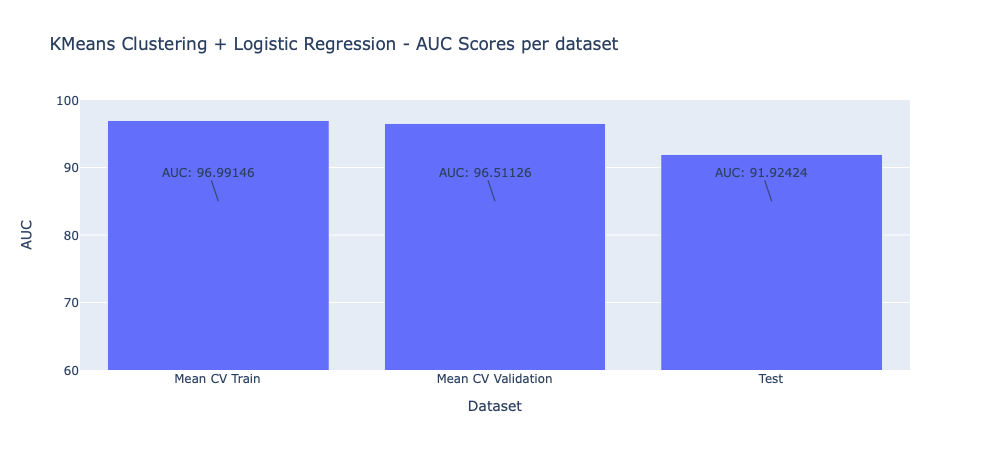

In [13]:
make_bar_plot_per_model(kmeans_cluster_model, "KMeans Clustering + Logistic Regression - AUC Scores per dataset")

KMeans Clustering + Logistic Regression does not appear to be overfitting. The mean training AUC (96.99) and mean validation AUC (96.51) from the 10-fold cross validation are very close to each other. The test AUC (91.92) from the unseen test data is not very far from the best-fit validation scores.

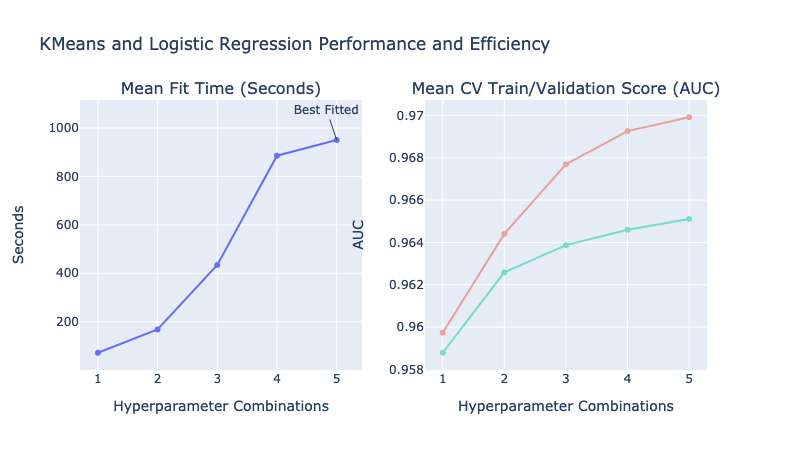

param_combination,mean_fit_time,param_kmeans__n_clusters,mean_train_score,mean_validation_score,rank_validation_score
1,71.538204,50,0.959738,0.958789,5
2,167.747817,100,0.964405,0.962587,4
3,434.057652,200,0.967692,0.963876,3
4,885.617909,300,0.969260,0.964601,2
5,950.432700,350,0.969915,0.965113,1


In [14]:
plot(kmeans_summary, "KMeans and Logistic Regression")

Although KMeans produces the best results from a prediction standpoint, this comes at the cost of a higher training time. The KMeans model took 33 minutes 1 second to train, with an average 10-fold CV training time of 8 minues 21 seconds. Of note, this training time is for our reduced datset of 40,000 instances. 

Train accuracy: 0.96967
Test result:
              precision    recall  f1-score   support

           0       0.63      0.92      0.74       993
           1       0.99      0.92      0.95      7007

    accuracy                           0.92      8000
   macro avg       0.81      0.92      0.85      8000
weighted avg       0.94      0.92      0.93      8000

Test AUC: 0.91924


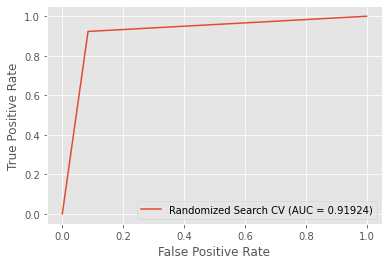

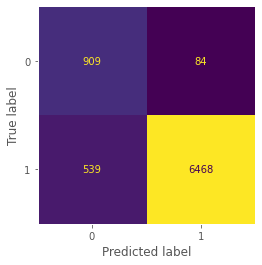

In [15]:
get_classification_report(X_train, y_train, X_test, y_test, yhat_kmeans, search_kmeans)

Our KMeans + Logistic model produces a test AUC of 91.92%, the highest of all models with cluster analysis preprocessing. The test AUC measures how well the model generalizes to unseen data. It also has the highest precision and recall, meaning there will be fewer false negatives for both classes in this model than any other. This will provide LendingClub with more accurate predictions.

### Birch Clustering with only numeric variables + Logistic Regression

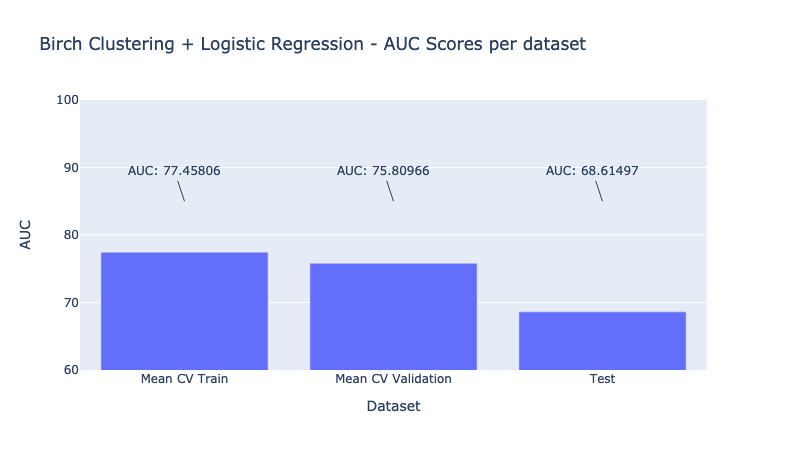

In [14]:
make_bar_plot_per_model(birch_cluster_model, "Birch Clustering + Logistic Regression - AUC Scores per dataset")

Birch Clustering + Logistic Regression shows possible evidence of overfitting. The mean train AUC (77.46) is slightly higher than the mean validation AUC (75.81), and the test AUC (68.61) is 7 percentage points lower than the validation AUC.

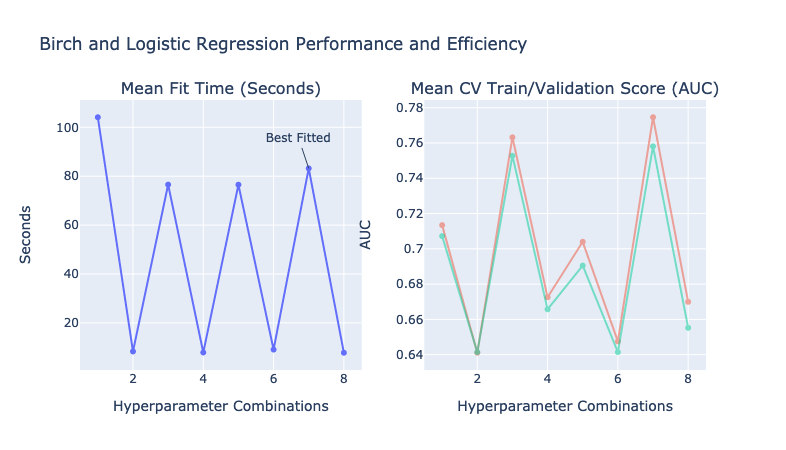

param_combination,rank_validation_score,mean_fit_time,param_preprocessing__n_clusters,param_preprocessing__threadshold,mean_train_score,mean_validation_score
1,3,104.113804,50,1.5,0.713441,0.707218
2,8,8.302612,50,3,0.641087,0.641440
3,2,76.557562,100,1.5,0.763209,0.752762
4,5,7.884124,100,3,0.672556,0.665720
5,4,76.513833,50,1.5,0.703980,0.690496
6,7,9.078580,50,3,0.647511,0.641463
7,1,83.183154,100,1.5,0.774581,0.758097
8,6,7.773403,100,3,0.669942,0.655201


In [15]:
plot(birch_summary, "Birch and Logistic Regression")

Birch Clustering + Logistic Regression has a relatively short training time, averaging 46 seconds for a 10-fold CV. Unfortunately, its predictive performance is not strong enough to provide much practical usefulness.

Train accuracy: 0.77024
Test result:
              precision    recall  f1-score   support

           0       0.23      0.71      0.35       993
           1       0.94      0.66      0.78      7007

    accuracy                           0.67      8000
   macro avg       0.59      0.69      0.56      8000
weighted avg       0.85      0.67      0.72      8000

Test AUC: 0.68615
CPU times: user 14.3 s, sys: 8.42 s, total: 22.7 s
Wall time: 6.06 s


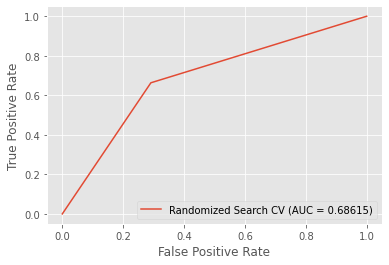

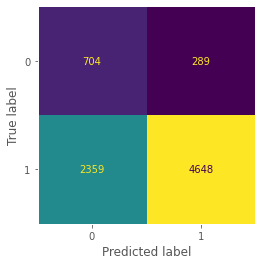

In [16]:
%%time
get_classification_report(X_train, y_train, X_test, y_test, y_hat_birch, search_birch)

Birch Clustering + Logistic Regression has a test AUC of 68.62%. While it is still better than chance (50%), when compared with the KMeans model (91.92%), the poor performance of this model is apparent. Additionally, the precision and recall for the minority class, as well as the recall for the majority class, are all quite low. This model would result in a high number of false positives and negatives. 

### Spectral Clustering with only numeric variables + Logistic Regression

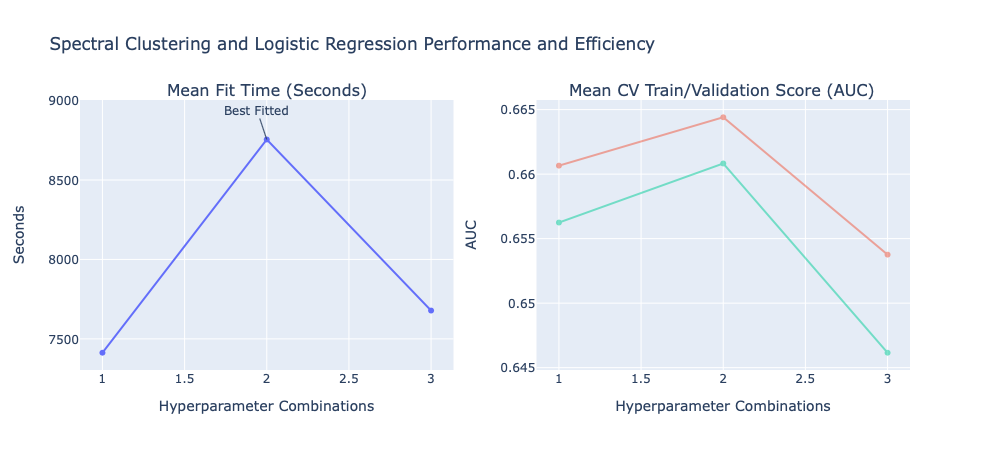

param_combination,rank_validation_score,mean_fit_time,param_clustering__n_clusters,param_clustering__n_neighbors,mean_train_score,mean_validation_score
1,2,7412.631912,50,10,0.660656,0.656246
2,1,8754.956309,50,15,0.664407,0.660824
3,3,7678.184009,50,20,0.653758,0.646156


In [14]:
plot(spectral_summary, "Spectral Clustering and Logistic Regression")

Spectral Clustering + Logistic Regression has a long training time, averaging over 2 hours for a 10-fold CV. This is a very time-intensive model to train.

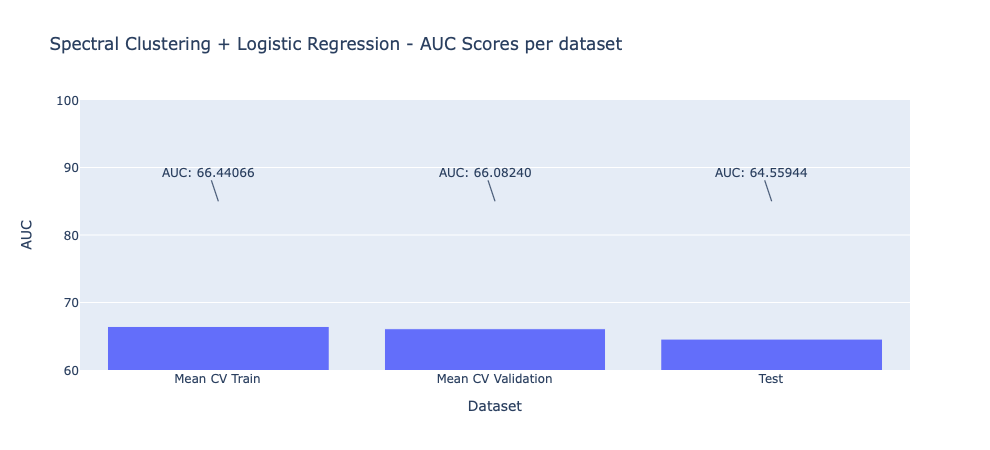

Train accuracy: 0.66817
Test result:
              precision    recall  f1-score   support

           0       0.17      0.90      0.29       993
           1       0.96      0.39      0.56      7007

    accuracy                           0.45      8000
   macro avg       0.57      0.65      0.42      8000
weighted avg       0.87      0.45      0.52      8000

Test AUC: 0.64559


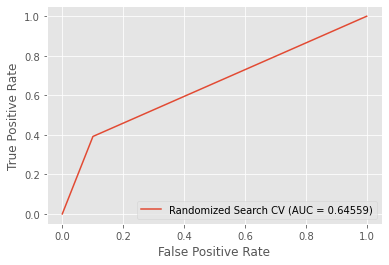

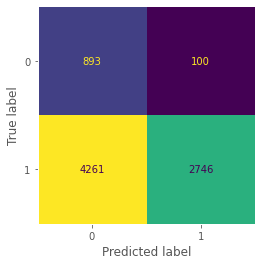

In [15]:
make_bar_plot_per_model(spectral_cluster_model, "Spectral Clustering + Logistic Regression - AUC Scores per dataset")
get_classification_report(X_train, y_train, X_test, y_test, spectral_y_hat, search_spectral)

Spectral Clustering + Logistic Regression does not appear to be overfitting. The mean training AUC (66.44) and mean validation AUC (66.08) from the 10-fold cross validation are very close to each other. The test AUC (64.56) from the unseen test data is not very far from the best-fit validation scores. Unfortunately, the test AUC, while still better than chance, is even worse than the Birch Clustering + Logistic model. While this model identifies a large proportion of the "bad" loans, it does this at the cost of classifying many "good" loans as "bad." Ultimately, the performance of this model is not strong enough to recommend its usage.

### Gaussian Mixtures with only numeric variables + Logistic Regression

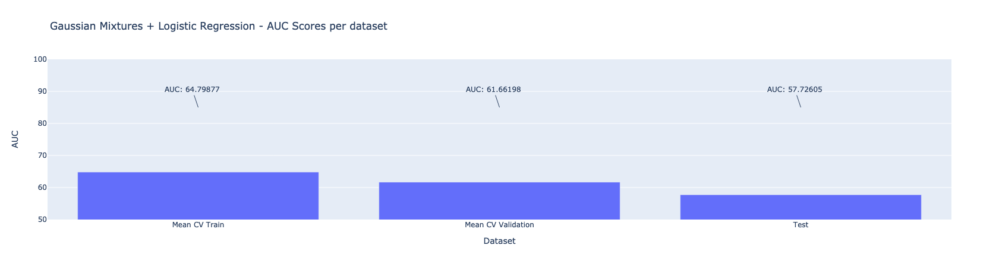

In [16]:
make_bar_plot_per_model(gm_cluster_model, "Gaussian Mixtures + Logistic Regression - AUC Scores per dataset")

Gaussian Mixtures + Logistic Regression does not appear to be overfitting. The mean training AUC (64.80) and mean validation AUC (61.66) from the 10-fold cross validation are fairly close to each other. The test AUC (57.73) from the unseen test data is a bit lower than the best-fit validation scores, but the difference is not too drastic. Unfortunately, the test AUC value is the lowest of all models.

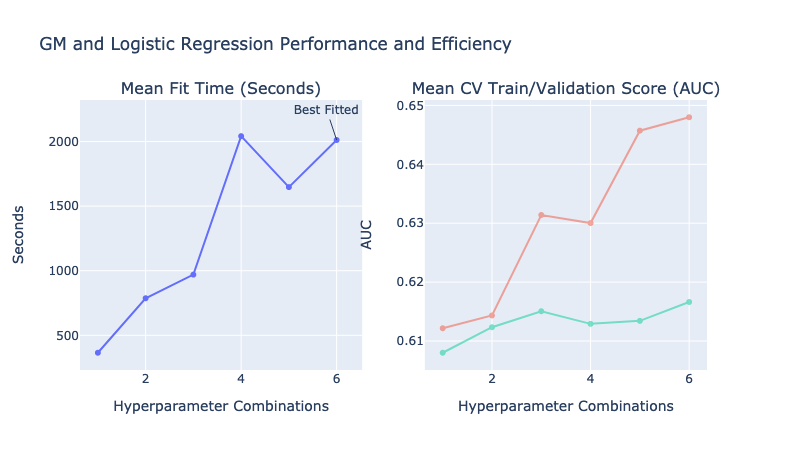

param_combination,rank_validation_score,mean_fit_time,param_clustering__clustering__n_init,param_clustering__clustering__n_components,mean_train_score,mean_validation_score
1,6,365.032187,1,50,0.612159,0.608003
2,5,787.016130,2,50,0.614329,0.612336
3,2,970.040737,1,100,0.631394,0.615055
4,4,2041.920013,2,100,0.630025,0.612909
5,3,1647.426186,1,150,0.645709,0.613418
6,1,2011.966251,2,150,0.647988,0.616620


In [17]:
plot(gm_summary, "GM and Logistic Regression")

Gaussian Mixtures + Logistic Regression has a training time average of 21 minues 43 seconds per 10-fold CV, longer than KMeans or Birch, but much shorter than Spectral. Unfortunately, the longer training time does not produce better predictions than KMeans or Birch, so there is not much benefit to this increased cost.

Train accuracy: 0.64944
Test result:
              precision    recall  f1-score   support

           0       0.16      0.67      0.25       993
           1       0.91      0.48      0.63      7007

    accuracy                           0.50      8000
   macro avg       0.53      0.58      0.44      8000
weighted avg       0.82      0.50      0.58      8000

Test AUC: 0.57726


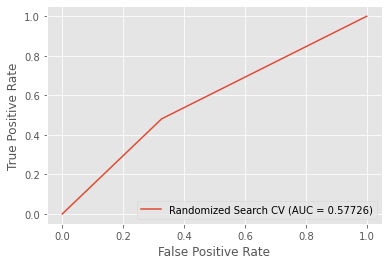

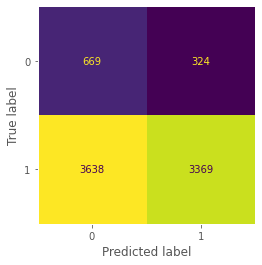

In [18]:
get_classification_report(X_train, y_train, X_test, y_test, y_hat_test_gm, search_gm)

Gaussian Mixtures + Logistic Regression produces a test AUC of 57.73% (slightly higher than chance). As can be seen in the heatmap above, this model is not particularly good at correctly classifying the majority class. It is not a very useful model for our current purposes.

# Modeling and Evaluation 4: Summarize the Ramifications

<b>Overall results</b>  

Our goal for this lab was to explore clustering as a preprocessing technique in order to increase model performance when only using scaled numerical variables.  Using this technique, based on the results for our loan dataset, it seems that clustering does not provide any additional value and in fact it reduces the overall model accuracy (possibly due to overfitting) with the exception of using the kmeans method. 

Our best model was the logistic regression using clusters returned by the Kmeans method. 
The model with the most efficient training time was the one using Birch clustering. Note that all models have different grid sizes so that might of impact total training time for each.  

Given more time and computational resources we would of liked to expand our exploration and modeling the following ways:
- increase the gridsearch for the hyperparameters on the clustering methods
- try more powerful predictive models such as xgboost


## KMeans Clustering

<b>Results Summary</b>

For this model, the best mean train/validation AUC scores (train:0.9699, validation: 0.9611) come hyperparameter combination #5 which using 350 clusters. The AUC score for the test data is 0.9192. 
As seen in the model and evaluation training time table, this model was the second most efficient in training time, lasting 24mins and 17secs. 

Pros
- Easy to implement: Compared to other methods Kmeans is relative easily to implement. The scikit-learn API provides a fit_transform method which makes it well suited method to implement in scikit-learn standard pipelines. 
- Scales well in large data sets
- Performance is good on different cluster shapes



Cons

- Sensitive to outliers. The centriods can be artificially offset by outliers in the dateset. 
- Numerical scaling. Kmeans is sensitive to scaling. Rescaling the data will change the clustering results. 
- Only handles numerical variables: As with many other clustering algorithm, Kmeans can only be used with continuous data. 


## Birch Clustering

<b>Results Summary</b>

For this model, the best mean train/validation AUC scores (train:0.9699, validation: 0.9611) come hyperparameter combination #7 which using 150  clusters and a thresholds of 1.5. The AUC score for the test data is 0.6861. 
As seen in the model and evaluation training time table, this model was the most efficient in training time, lasting 8mins and 16secs. 

Pros
- Efficient training time since Birch utilize Tree like structure for clustering (CF-tree).
- Birch also attempts to minimize memory requirement for large datasets by summarizing information contained in dense area as clustering feature entries.

Resources: https://towardsdatascience.com/machine-learning-birch-clustering-algorithm-clearly-explained-fb9838cbeed9

Cons
- Not easy to implement on Scikit-learn using pipelines.  To do this you need to create a custom transformer with a fit_transform method. 

## Spectral Clustering

<b>Results Summary</b>

For this model, the best mean train/validation AUC scores (train:0.6644, validation: 0.6608) come hyperparameter combination #6 which used 150 n_clusters and 15 n_neighbors. The AUC score for the test data is 0.6455. 
As seen in the model and evaluation training time table, this model was the least efficient in training time, lasting 7hr and 32mins. 

Pros
- Cluster label assignment is based on a spectrum (eigenvector dcomposition) of connectedness and the not just distance or density. This means that it is possible that our spectral clustering model is able to detect unusual cluster shapes that bend.
- spectral clustering is especially good at image or map data so using this algorithm on any data that can be made to ressemble an image, would probalby be a good candidate for spectral clustering. 
- Spetral clustering can be used to help with dimensionality reductinon.

Cons
- Not easy to implement on Scikit-learn using pipelines.  To do this you need to create a custom transformer with a fit_transform method AND a KNN layer. 
- There isn't really a "fit" function for the Spectralcluster package we used, and more in general, spectral clustering is really built to be trained and then used on new date (transformed). To make Spectral clustering behave like a trainable algorithm, we had to add a K nearest neighbor layer to our custom spectral clustering transformer. This essentially uses the spetral cluster assignmet labels from a training set and predicts cluster label assignment. The main ramification of this is technique is that we need to know that our training data has close to all known clusters represented in it (stratified). 
- Spectral clusering can be computationally complex as there are several steps to the algorithm. 
- Our implemenetation probably has a tendency to overfit if our KNN layer is not appropriately tuned as well. 

#### When to use this model and ramifications: 

If we know the cluster label assignments are well represented in a image like sample data set, and that the clusters are not gausian or globular, but instead are defined by connectendness. 

Using spectral clustering as a preprocessor has high space and time complexiy, an avenue to explore would be how to preprocess data before spetral clustering and its associated cluseter label prediction. Maybe Dimensionality reduction with Singular value decomposition or PCA could be used to reduce dimensionality and preserve information or explained variance such that cluster label assignments are still meaningful when validated. Another idea would be to look into kernelizing our spectral model with something like RBF. this is already supported, it is just EVEN more computationally complex. 

As far as our loan dataset, it is clear that spectral clustering did not improve the results of predicting `good_loan_or_bad`, probably because it is already linearly seperable and logistic regression already does a good job. 

Maybe a better application of spectral clusetering for this specific dataset would be to use it to help guide the discovery of new explanatory variables which could help in the Lending process. 


## Gaussian Mixtures

<b>Results Summary</b>

For this model, the best mean train/validation AUC scores (train:0.6479, validation: 0.6166) come hyperparameter combination  #6 which used 150 clustering components and n_init=2. The AUC score for the test data is 0.5777. 
As seen in the model and evaluation training time table, this model was the third most efficient in training time, lasting 1hr and 36mins. 

Pros
- We are able to train our custom transformer using expectation maximization with 'Full' covariances to allow for different shapes and types of clusters. 
- This algorithm is built to be trained and does not require another layer such as KNN. 
- with enough iterations, gaussian mixtures is guaranteed to converge 
- Clustser Label assignment can be used in a dimensionality reduction pipeline. 

Cons
- Not easy to implement on Scikit-learn using pipelines.  To do this you need to create a custom transformer with a fit_transform method.
- Somewhat high computational complexity when the number of initializations or components is high, or if we choose the full covariance in a grid.
- Clusters are assumed to be multivariate gaussian. This may not be the case for each cluster. 
- Full Covariance may tend to overfit. 
- Similar to Spectral clustering, all clusters must be well represented in the training data. If not, label assignment may be flawed. 
- overfitting is possible with a high number of components. 
- Is built for numerical data. There may be a way to modify expectation maximization for one hot encoded variables, but it is not obvious how to do that or what it would even mean. 


Gaussian mixtures as a preprocessor, like many of the previoiusly mentioned cluster label assignment as a preprocesor algorithms did not improve our prediction strength for the already linearly seperable loan dataset. 

With more time we would explore different weights, intialization schemes like k-means, and possibly lookign into making gaussian mixtures models compatible with categorical data (if possible).  

# Deployment

### Goal
Our goal was to explore the usefulness of cluster analysis as a preprocessing tool to improve our predictive modeling of loan outcomes using LendingClub data. While we were successful in implementing and exploring a variety of cluster analysis techniques, the marginal benefit of preprocessing with cluster analysis for seems to be very slight. Only one method of cluster analysis (KMeans) produced any benefit above straighforward logistic regression, and that benefit may not have been significant. Using KMeans to preprocess also comes at a cost as far as training time. The increased training time may not be worth the trade-off for a marginal, possibly insignificant, improvement in predictions.  

If an interested party found the increased training time acceptable, the KMeans + Logistic Regression model could be used in the following ways:
 

### Interested Party: LendingClub  
LendingClub itself could use this model to identify current loans with higher odds of default. Because our model contains variables that are collected during the course of the loan (such as last_fico or last_pymnt_amnt), it could identify higher risk loans and allow LendingClub to take steps to intervene if necessary. The particular steps taken to intervene are outside the purview of this analysis, but they could include contact with the loan recipient, adjustment of payment amount, or extending hardship status proactively. If any of these steps lead to at least the partial recoup of loan payments that would have otherwise defaulted, the result would be an increased return for LendingClub. 

It is safe to assume that LendingClub uses its own algorithm to predict loan outcomes. Unfortunately, this model is not available to the public. If our model has more accurate predictions than the one they currently use, it could be used to identify high risk current loans. If our model has higher sensitivity and specificity than their current model, it would give the company more granularity when deciding on intervention measures. Comparison of the auc_roc values could be used to measure this improvement over a current model, with higher auc_roc indicating a better sensitivity and specificity. From a business standpoint, a decrease in the percentage of defaulted loans or an increase in the total received principal would measure the effectiveness of this model as an intervention measure. 

This model could be deployed by integrating it into LendingClub’s routine pipeline. When relevant updated information is collected (such as last_fico or last_pymnt_amnt), the model could give an updated assessment of default risk. Those loan recipients flagged at a certain risk level could be passed on to a representative for possible intervention measures. Additional data regarding the successful interventions and the characteristics of the loans associated with them would be useful to refine intervention methods. Updates to the model could be made as soon as this data became available. Additionally, general updates for models involving financial data should be conducted on a regular basis (potentially every year) or if there are any major changes to the financial market.  

### Interested Party: Competitors  
Competitor peer-to-peer lending companies could also find this model useful. Start-up companies in particular might use it as a starting point when building their own models. LendingClub is established and successful, and predictions from this model regarding loan outcomes could be used as a baseline for their own decisions and processes, such as which loans to accept and how to apply any possible intervention measures. Of course, the competitor would need to collect the same information as LendingClub to use the model, and there would be possible limitations. Loan applicants to a less established company might have different characteristics and outcomes than those studied in this model.

The model’s value could once again be measured as a comparison of auc_roc values, comparing our model with any proposed model the start-up is considering. If our model has higher auc_roc values, the better sensitivity and specificity would give more clarity regarding which investments to make and when to take intervention measures. The identification of high risk loans can then be used to for intervention and hopefully an increase in repayment amount and decrease in percentage of defaults.  

As for deployment, a new competitor would eventually customize their model. This model would be most useful as a starting point and benchmark for prediction accuracy. It could be deployed in the initial modeling and decision-making phase. Additional data about clients and loan outcomes would then be collected from the competitor’s clients to customize the model. As previously mentioned, we cannot assume the client population to be exactly the same, so the new loan outcome data could be used to update the model for the competitor. At least in the beginning stages, this model would need to be updated as soon as any loan outcome data became available.  



# Exceptional Work

### Part 1

We have created custom transformers using BaseEstimator and TransformerMixin under Modeling and Evaluation 1 in order to fit Birch, Spectral, and Gaussian Mixtures clustering techniques into the pipeline to fine tune parameters using grid search. This is beyond the scope of class, so we feel this should be considered Exceptional Work.

### Part 2

In Modeling and Evaluation above, we subset our dataset into a 40,000 instance sample in order to explore many time and space intensive clustering techniques as a preprocessing step on numeric variables to feed to Logistic Regression. Below we are using the original full dataset of 100,000 instances (similar to Lab2). However, in addition to our model from Lab 2, we added KMeans clustering as a preprocessing step, computed clustering, and transformed X to cluster-distance space. We are using the all original predictors (categorical and numeric) from Lab 2 as well as cluster-distance space from KMeans to predict the response `good_loan_or_not`. We then tuned the KMeans parameter "n_clusters" to find the best number of clusters to improve prediction accuracy.

To utilize Pipeline for this model, we created two pipelines. One (pipeline_kmeans) takes the numeric values, scales them, and then runs KMeans clustering. The second (colums_transformer_pipe) one hot encodes the categorical values and scales the numeric values. Finally, we used FeatureUnion to run both of these pipelines in parallel, merge them, and then fit a logistic regression classifier.

We used grid search to compare models with different values of the parameter n_clusters. n_clusters adjusts the number of clusters formed. grid_kmeans contains the different values for n_clusters.

**Reload data with 100k sample and refresh train/test split**

In [8]:
path = f"{d}/data/loan_100k_sample0709.pkl"
%time data = joblib.load(path)
# set variables to drop
drop_vars = ["debt_settlement_flag","recoveries","total_rec_late_fee","delinq_amnt","out_prncp","total_rec_prncp", 
             "addr_state","loan_status","issue_d","earliest_cr_line","last_pymnt_d","int_rate"]

X_train, X_test, y_train, y_test, categorical_col, numeric_col, categorical_ix, numeric_ix = \
                get_train_test_dataset(data, drop_vars, "good_loan_or_not")

CPU times: user 75.4 ms, sys: 30.8 ms, total: 106 ms
Wall time: 105 ms


In [9]:
# Define pipeline for using kmeans
pipeline_kmeans = Pipeline(steps=[
    ('preprocessing',ColumnTransformer([('scale',StandardScaler(), numeric_ix)], remainder='drop')),
    ("kmeans", KMeans(random_state=101))
])
# Define ColumnTransformer with original lab2 predictors
colums_transformer_pipe = Pipeline(steps=[
    ('preprocessing', ColumnTransformer( [('cat', OneHotEncoder(drop = reference_levels_to_drop), 
                                           categorical_ix), 
     ('scale',StandardScaler(), numeric_ix)],remainder='passthrough'))])


In [10]:
# using original predictors + clustering + Logistic Regression 
kmeans_lr_pipeline = Pipeline([
   ( "features",  FeatureUnion([ 
         ("standard_preprocessing", colums_transformer_pipe),
        ("clustering", pipeline_kmeans)
    ])
   ), 
   ('model', LogisticRegression(class_weight='balanced',
                                max_iter=15000,
                                penalty="l2",
                                fit_intercept=True,
                                solver="liblinear",
                                C=100,
                                random_state=111)) 
])

# Define grid for turning best n_clusters
grid_kmeans = {
         "features__clustering__kmeans__n_clusters": [50, 100, 150, 200, 250, 300, 350, 400 ,450, 500],

}

####
# Explanation of above:
# pipeline_kmeans: is a pipeline from all the data provided it only takes numerical features (drops categorical)
# scales it and then runs kmeans clustering
# colums_transformer_pipe: is a pipeline from all the data provided it takes both numerical features and categorica
# and performs the scaling abd one hot encoding respectively

# FeatureUnion runs both of these pipelines in parallel and merges the results into a single array
# then a logistic regression classifier makes classifications  
####

In [11]:
kmeans_search = GridSearchCV(kmeans_lr_pipeline, grid_kmeans, cv=cv, scoring='roc_auc',
                                n_jobs=-1, verbose=15, return_train_score=True)

In [118]:
%%time
kmeans_fit = kmeans_search.fit(X_train,y_train)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
CPU times: user 9min 21s, sys: 2min 25s, total: 11min 47s
Wall time: 8h 40min 56s


Total training time for this model was 8 hours 40 minutes. This is the longest training time of the models trained for this project; however, this was the only model to train on all 100,000 instances so it is not entirely fair to compare these times to each other.

In [12]:
#save_load(True, "cluster_lr_3", kmeans_fit)
# Load in cluster_lr_3 where original kmeans_fit is pickled
kmeans_fit = save_load(False, "cluster_lr_3")
# Load in lr to display original Logistic Regression performance from Lab2
model_lr = save_load(False, "lr")

For a more accurate comparison, we have referenced a logistic regression model from Lab 2. This model scales the numeric variables, hot encodes the categorical variables, and then fits the logistic regression model. It also used the full 100,000 instance dataset. In this way, we can determine if there are any added benefits to incorporating a cluster analysis preprocessing step into the full numeric and categorical logistic regression model.

In [13]:
y_hat_test = kmeans_fit.predict(X_test)
y_hat_lr = model_lr.predict(X_test)

In [14]:
lr_results_cols = ["rank_test_score", "mean_fit_time", "param_model__solver", "param_model__penalty", "param_model__C",
                   "param_model__class_weight", "param_model__max_iter" ,"param_model__fit_intercept", "mean_train_score",
                   "mean_test_score"]

lr_cluster_results_cols = ["rank_test_score", "mean_fit_time", "param_features__clustering__kmeans__n_clusters", "mean_train_score",
                   "mean_test_score"]

lr_cluster_summary = add_text(cv_summary(kmeans_fit, lr_cluster_results_cols),"lr_cluster")

lr_cluster_model= {
    "Mean CV Train": lr_cluster_summary[lr_cluster_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": lr_cluster_summary[lr_cluster_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, y_hat_test)*100
}

lr_summary = add_text(cv_summary(model_lr, lr_results_cols),"lr")

lr_model= {
    "Mean CV Train": lr_summary[lr_summary["rank_validation_score"]==1].mean_train_score.values[0]*100 , 
    "Mean CV Validation": lr_summary[lr_summary["rank_validation_score"]==1].mean_validation_score.values[0]*100,
    "Test": get_auc( y_test, y_hat_lr)*100
}

As we can see from the comparison below, Train, Validation, and Test scores all slightly improve with clustering distance space added as predictors (in addition to original numeric and categorical predictors.) However, the improvement is not very significant. Best test AUC with clustering is 0.927 and best number of clusters was 150.

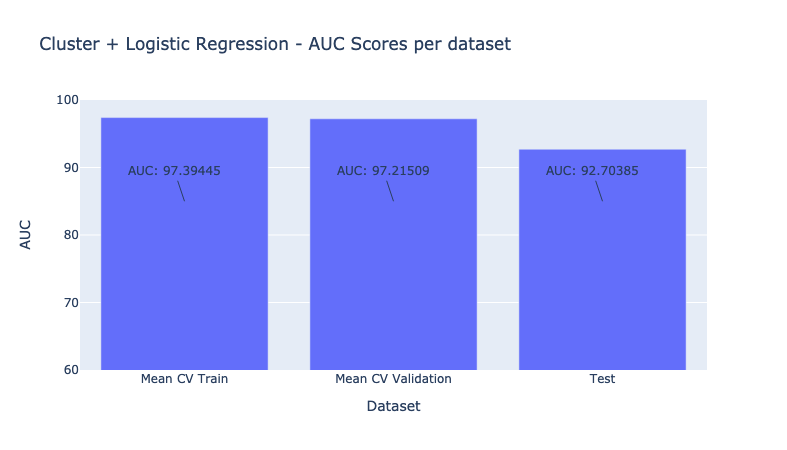

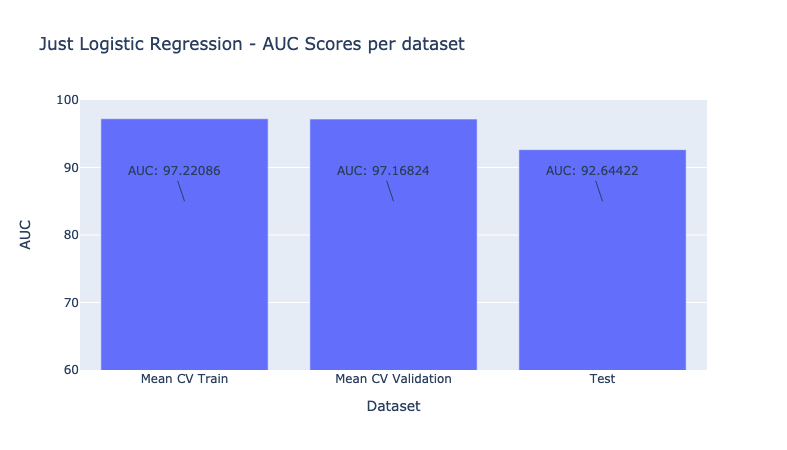

In [15]:
make_bar_plot_per_model(lr_cluster_model, "Cluster + Logistic Regression - AUC Scores per dataset")
make_bar_plot_per_model(lr_model, "Just Logistic Regression - AUC Scores per dataset")

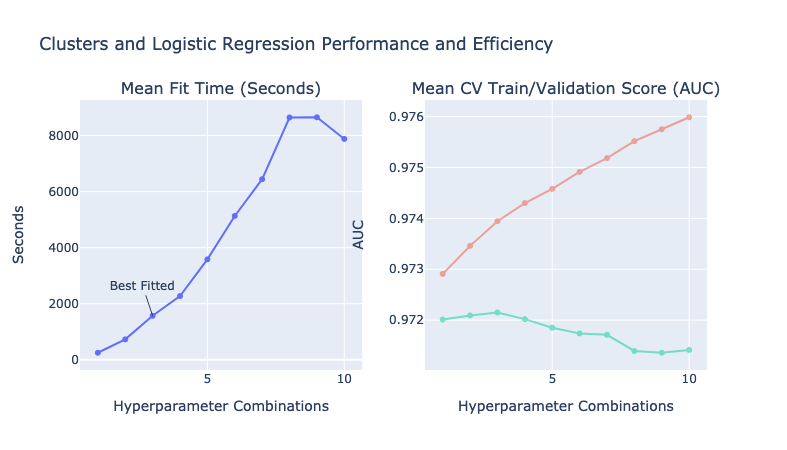

param_combination,rank_validation_score,mean_fit_time,param_features__clustering__kmeans__n_clusters,mean_train_score,mean_validation_score
1,4,249.022861,50,0.972909,0.972012
2,2,726.894755,100,0.973460,0.972093
3,1,1567.718090,150,0.973944,0.972151
4,3,2272.503709,200,0.974300,0.972020
5,5,3580.868441,250,0.974580,0.971851
6,6,5130.388624,300,0.974913,0.971739
7,7,6442.273056,350,0.975186,0.971712
8,9,8643.466439,400,0.975517,0.971394
9,10,8652.175393,450,0.975752,0.971360
10,8,7878.852090,500,0.975987,0.971415


Train accuracy: 0.97394
Test result:
              precision    recall  f1-score   support

           0       0.65      0.93      0.76      2483
           1       0.99      0.93      0.96     17517

    accuracy                           0.93     20000
   macro avg       0.82      0.93      0.86     20000
weighted avg       0.95      0.93      0.93     20000

Test AUC: 0.92704


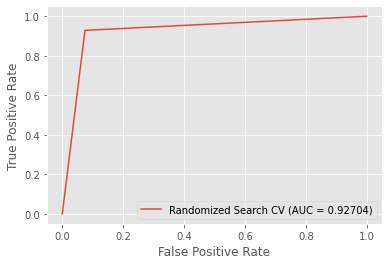

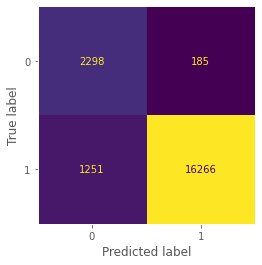

In [16]:
plot(lr_cluster_summary, "Clusters and Logistic Regression")
get_classification_report(X_train, y_train, X_test, y_test, y_hat_test, kmeans_fit)

While the test AUC score (.9270) for KMeans Cluster + Logistic Regression (numeric and categorical) is slightly higher than the test AUC score for Logistic Regression (.9264), it is unlikely this is a significant difference. There does not appear to be enough added benefit to merit the addition of KMeans clustering pre-processing to the full logistic regression model.